In [1]:
%matplotlib inline

# install pillow
!pip install Pillow -U

# # download and unzip dataset o train
# !wget http://images.cocodataset.org/zips/val2014.zip
# !mkdir train
# %cd /content/train
# !unzip -qq /content/val2014.zip
# %cd ..

#download model
!wget https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth

     |████████████████████████████████| 4.3 MB 32.3 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


--2022-05-03 14:32:41--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  14.6MB/s    in 38s     

2022-05-03 14:33:20 (13.9 MB/s) - ‘vgg16-00b39a1b.pth’ saved [553451520/553451520]



# Style Transfer Training

## Import Library

In [2]:
import torch
import torch.nn as nn
import PIL
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
%matplotlib inline

# get utils functions
# from utils import grammatrix, loss_of_style, loss_of_content, content_transform, detransform_content, rescale

from PIL import Image
import cv2
import torch.optim as optim
from torchvision import datasets, transforms, models
import random
import numpy as np
import time
import vgg16_fe as vgg # this is used to extract features
import custom_model
import utils
# import vgg16 as vgg_style


In [3]:
!sh download_data.sh

Streaming output truncated to the last 5000 lines.
  inflating: tiny-imagenet-200/val/images/val_3979.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3963.JPEG  
  inflating: tiny-imagenet-200/val/images/val_7199.JPEG  
  inflating: tiny-imagenet-200/val/images/val_2752.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9687.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9407.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3603.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3412.JPEG  
  inflating: tiny-imagenet-200/val/images/val_6982.JPEG  
  inflating: tiny-imagenet-200/val/images/val_8496.JPEG  
  inflating: tiny-imagenet-200/val/images/val_7332.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9241.JPEG  
  inflating: tiny-imagenet-200/val/images/val_4196.JPEG  
  inflating: tiny-imagenet-200/val/images/val_5980.JPEG  
  inflating: tiny-imagenet-200/val/images/val_6697.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9969.JPEG  
  inflating: tiny-ima

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# Trained on TinyImageNet dataset for different styles

## Udnie

In [10]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/udnie.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "udnie/models/"
SAVE_IMAGE_PATH = "udnie/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

In [13]:
def train():
    # seeds
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

    # get the device
    device = ("cuda" if torch.cuda.is_available() else "cpu")

    # load the training dataset
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

    # load the models and start training :)
    model = custom_model.CustomModel().to(device)
    vgg16_fe = vgg.VGG16('/content/vgg16-00b39a1b.pth').to(device)

    # get style features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    # load the style image
    style_image = utils.load_image(STYLE_IMAGE_PATH)
    # convert style image to tensor
    style_tensor = utils.itot(style_image).to(device)
    # add imagenet mean
    style_tensor = style_tensor.add(imagenet_neg_mean)

    B, C, H, W = style_tensor.shape
    # get the features of the style image
    style_features = vgg16_fe(style_tensor.expand([BATCH_SIZE, C, H, W]))

    # get the gram matrix of the style image
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = utils.gram(value)

    # Optimizer settings
    optimizer = optim.Adam(model.parameters(), lr=ADAM_LR)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()

    # training loop
    for epoch in range(NUM_EPOCHS):
        print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            # free up unnecessary memory of cuda
            torch.cuda.empty_cache()

            # zero the gradients
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = model(content_batch)
            content_features = vgg16_fe(content_batch.add(imagenet_neg_mean))
            generated_features = vgg16_fe(generated_batch.add(imagenet_neg_mean))

            # Calculate content loss
            MSELoss = nn.MSELoss().to(device)
            content_loss = CONTENT_WEIGHT * MSELoss(generated_features['relu1_2'], content_features['relu1_2'])            
            batch_content_loss_sum += content_loss

            # Calculate style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = MSELoss(utils.gram(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Calculate total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backpropagation
            total_loss.backward()
            optimizer.step()

            # Save Model and Print Losses
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                # Print Losses
                print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*len(train_loader)))
                print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("Time elapsed:\t{} seconds".format(time.time()-start_time))

                # Save Model
                checkpoint_path = SAVE_MODEL_PATH + "checkpoint_" + str(batch_count-1) + ".pth"
                torch.save(model.state_dict(), checkpoint_path)
                
                print("Saved CustomModel checkpoint file at {}".format(checkpoint_path))

                # Save sample generated image
                sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0) # clone to save inplace errors
                sample_image = utils.ttoi(sample_tensor.clone().detach())
                sample_image_path = SAVE_IMAGE_PATH + "sample0_" + str(batch_count-1) + ".png"
                utils.saveimg(sample_image, sample_image_path)
                utils.show(sample_image)
                print("Saved sample stylized image at {}".format(sample_image_path))

                # Save loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)
            
            # increment batch count
            batch_count += 1
    
    stop_time = time.time()
    # Print loss histories
    print("Done Training the Network!")
    print("Training Time: {} seconds".format(stop_time-start_time))
    print("========Content Loss========")
    print(content_loss_history) 
    print("========Style Loss========")
    print(style_loss_history) 
    print("========Total Loss========")
    print(total_loss_history) 

    # Save TransformerNetwork weights
    model.eval()
    model.cpu()
    final_path = SAVE_MODEL_PATH + "transformer_weight.pth"
    print("Saving Custom Model weights at {}".format(final_path))
    torch.save(model.state_dict(), final_path)
    print("Done saving final model")

    # Plot Loss Histories
    if (PLOT_LOSS):
        utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)


========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	20193196.00
	Total Loss:	20985430.00
Time elapsed:	0.42380237579345703 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_0.pth


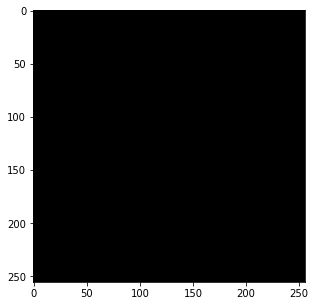

Saved sample stylized image at udnie/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	570280.25
	Style Loss:	2664404.96
	Total Loss:	3234685.38
Time elapsed:	125.64202976226807 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_500.pth


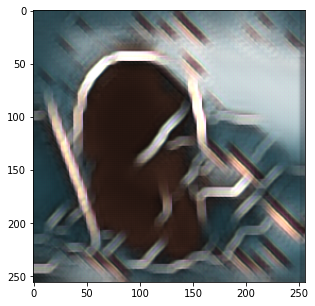

Saved sample stylized image at udnie/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	534084.44
	Style Loss:	1594137.00
	Total Loss:	2128221.55
Time elapsed:	251.6615879535675 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_1000.pth


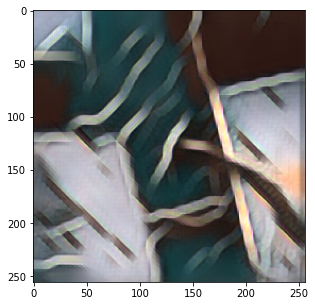

Saved sample stylized image at udnie/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	514720.34
	Style Loss:	1182547.44
	Total Loss:	1697267.51
Time elapsed:	378.56447672843933 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_1500.pth


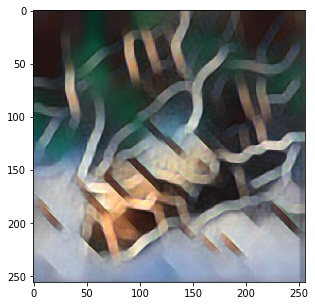

Saved sample stylized image at udnie/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	498994.41
	Style Loss:	958512.50
	Total Loss:	1457506.32
Time elapsed:	505.9184510707855 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_2000.pth


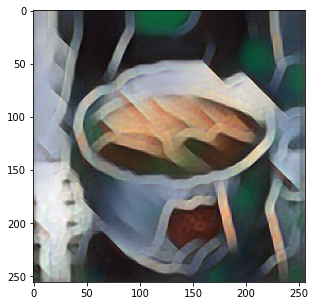

Saved sample stylized image at udnie/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	484807.97
	Style Loss:	816627.08
	Total Loss:	1301434.46
Time elapsed:	634.1186306476593 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_2500.pth


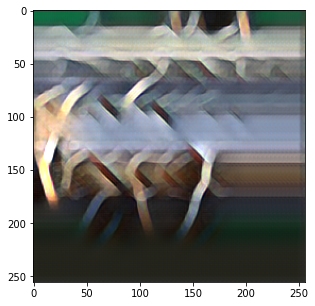

Saved sample stylized image at udnie/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	474651.91
	Style Loss:	718439.95
	Total Loss:	1193090.84
Time elapsed:	761.8906648159027 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_3000.pth


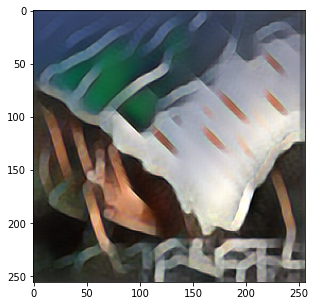

Saved sample stylized image at udnie/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	467158.19
	Style Loss:	645462.97
	Total Loss:	1112620.52
Time elapsed:	889.8905112743378 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_3500.pth


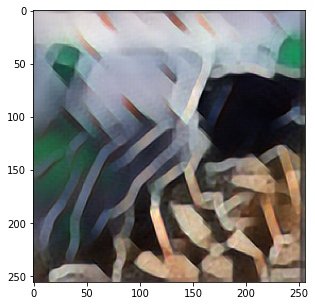

Saved sample stylized image at udnie/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	461355.34
	Style Loss:	588700.22
	Total Loss:	1050054.95
Time elapsed:	1017.4255518913269 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_4000.pth


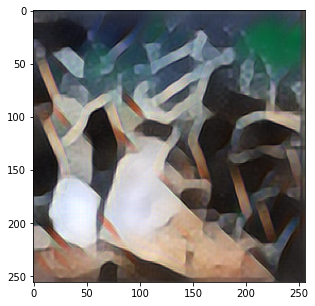

Saved sample stylized image at udnie/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	457857.19
	Style Loss:	543586.01
	Total Loss:	1001442.17
Time elapsed:	1145.5213811397552 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_4500.pth


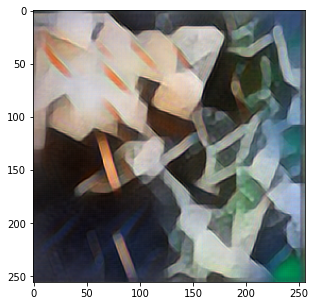

Saved sample stylized image at udnie/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	451775.03
	Style Loss:	506256.13
	Total Loss:	958029.93
Time elapsed:	1272.8976962566376 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_5000.pth


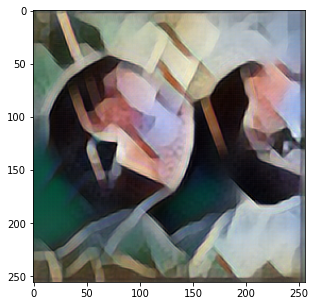

Saved sample stylized image at udnie/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	447149.06
	Style Loss:	475123.53
	Total Loss:	922270.89
Time elapsed:	1399.8348371982574 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_5500.pth


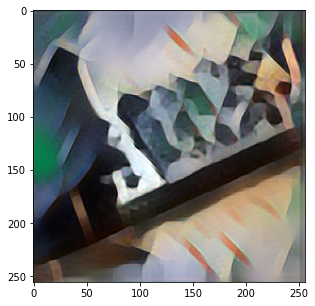

Saved sample stylized image at udnie/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	442390.66
	Style Loss:	448595.99
	Total Loss:	890985.26
Time elapsed:	1526.6937279701233 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_6000.pth


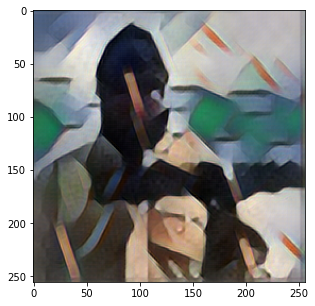

Saved sample stylized image at udnie/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	438706.19
	Style Loss:	425995.47
	Total Loss:	864700.56
Time elapsed:	1653.2020695209503 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_6500.pth


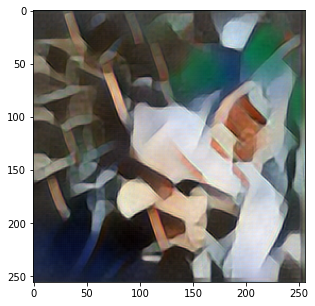

Saved sample stylized image at udnie/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	435446.44
	Style Loss:	406378.65
	Total Loss:	841824.08
Time elapsed:	1779.8292763233185 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_7000.pth


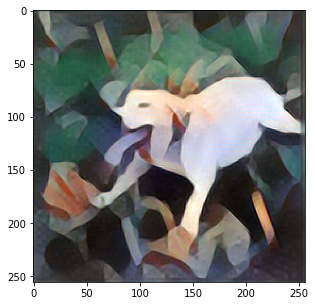

Saved sample stylized image at udnie/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	432877.06
	Style Loss:	388964.76
	Total Loss:	821840.99
Time elapsed:	1906.8041970729828 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_7500.pth


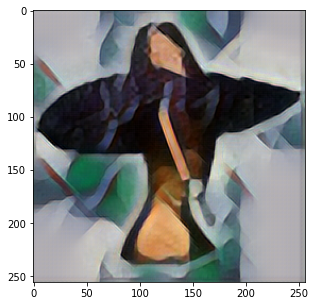

Saved sample stylized image at udnie/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	430549.12
	Style Loss:	373590.12
	Total Loss:	804138.30
Time elapsed:	2033.2642369270325 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_8000.pth


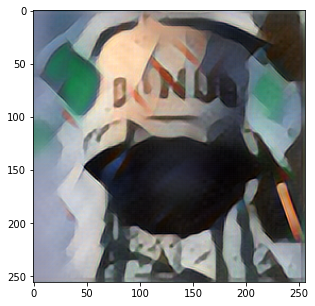

Saved sample stylized image at udnie/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	427977.56
	Style Loss:	359929.39
	Total Loss:	787906.29
Time elapsed:	2159.440521001816 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_8500.pth


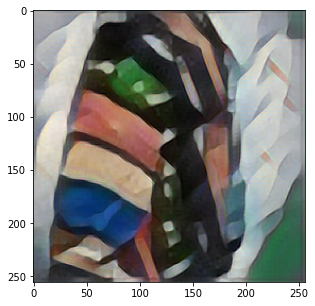

Saved sample stylized image at udnie/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	424881.94
	Style Loss:	347537.60
	Total Loss:	772418.60
Time elapsed:	2285.727102994919 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_9000.pth


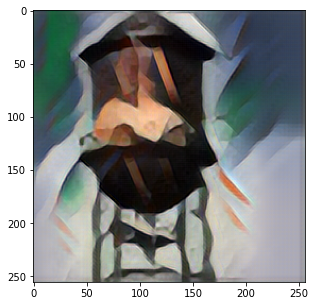

Saved sample stylized image at udnie/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	422554.31
	Style Loss:	336435.55
	Total Loss:	758989.06
Time elapsed:	2411.7183907032013 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_9500.pth


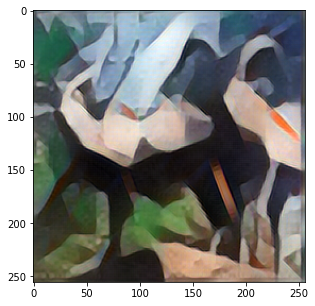

Saved sample stylized image at udnie/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	420440.41
	Style Loss:	326379.12
	Total Loss:	746818.68
Time elapsed:	2537.8326048851013 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_10000.pth


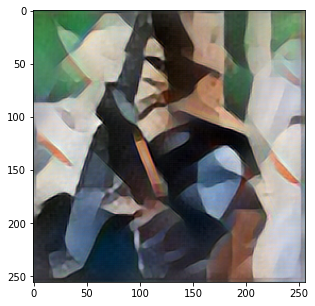

Saved sample stylized image at udnie/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	418298.59
	Style Loss:	317167.48
	Total Loss:	735464.86
Time elapsed:	2664.0261447429657 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_10500.pth


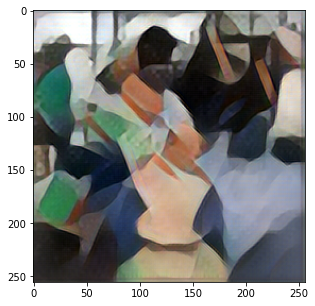

Saved sample stylized image at udnie/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	416288.56
	Style Loss:	308766.80
	Total Loss:	725053.75
Time elapsed:	2789.974589109421 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_11000.pth


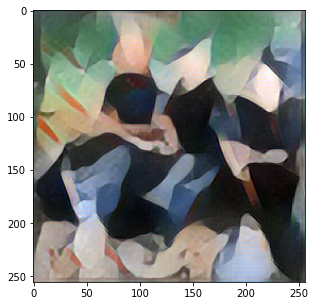

Saved sample stylized image at udnie/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	414633.06
	Style Loss:	301008.24
	Total Loss:	715640.24
Time elapsed:	2915.9036045074463 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_11500.pth


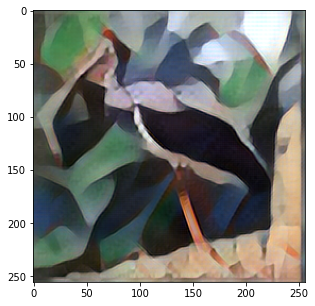

Saved sample stylized image at udnie/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	412535.34
	Style Loss:	293843.27
	Total Loss:	706377.71
Time elapsed:	3041.7734088897705 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_12000.pth


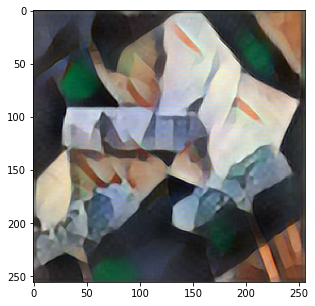

Saved sample stylized image at udnie/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	410997.69
	Style Loss:	287196.03
	Total Loss:	698192.44
Time elapsed:	3167.7710676193237 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_12500.pth


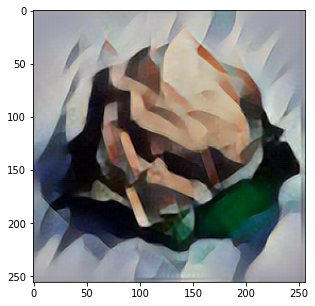

Saved sample stylized image at udnie/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	409868.00
	Style Loss:	281025.25
	Total Loss:	690892.33
Time elapsed:	3293.463620901108 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_13000.pth


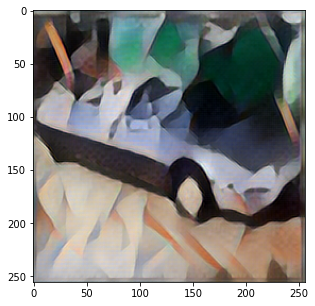

Saved sample stylized image at udnie/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	408279.81
	Style Loss:	275246.49
	Total Loss:	683525.06
Time elapsed:	3419.3693075180054 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_13500.pth


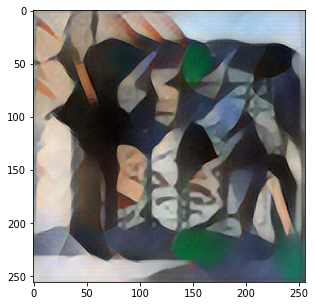

Saved sample stylized image at udnie/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	407011.97
	Style Loss:	269788.92
	Total Loss:	676799.82
Time elapsed:	3545.0746290683746 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_14000.pth


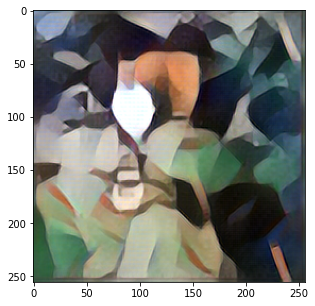

Saved sample stylized image at udnie/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	405631.56
	Style Loss:	264760.75
	Total Loss:	670391.63
Time elapsed:	3671.089051246643 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_14500.pth


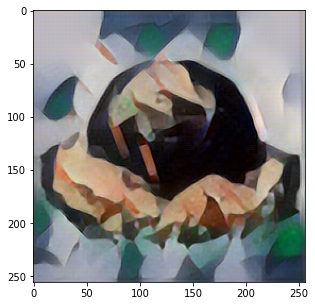

Saved sample stylized image at udnie/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	404255.03
	Style Loss:	260071.71
	Total Loss:	664325.89
Time elapsed:	3797.015324115753 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_15000.pth


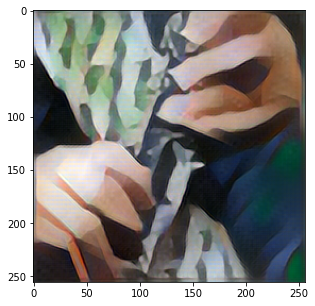

Saved sample stylized image at udnie/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	402951.09
	Style Loss:	255562.42
	Total Loss:	658512.79
Time elapsed:	3922.7609543800354 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_15500.pth


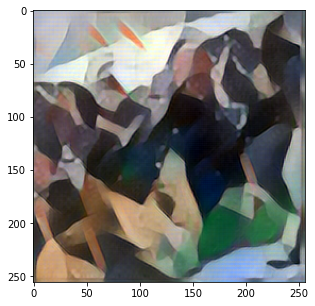

Saved sample stylized image at udnie/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	401842.69
	Style Loss:	251292.70
	Total Loss:	653134.34
Time elapsed:	4048.6996903419495 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_16000.pth


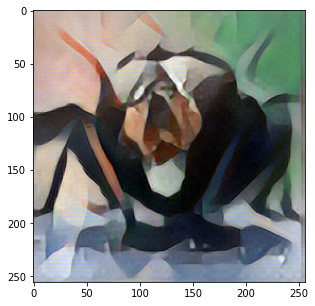

Saved sample stylized image at udnie/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	400748.22
	Style Loss:	247278.52
	Total Loss:	648025.69
Time elapsed:	4174.795393705368 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_16500.pth


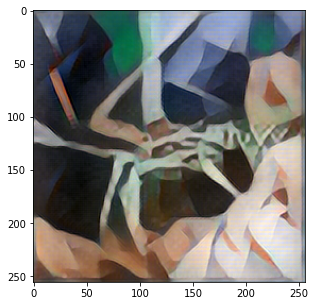

Saved sample stylized image at udnie/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	399875.69
	Style Loss:	243506.02
	Total Loss:	643380.52
Time elapsed:	4300.665187835693 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_17000.pth


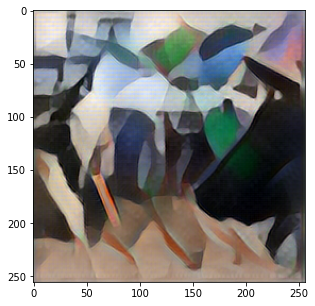

Saved sample stylized image at udnie/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	398635.53
	Style Loss:	239891.00
	Total Loss:	638525.73
Time elapsed:	4426.48298740387 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_17500.pth


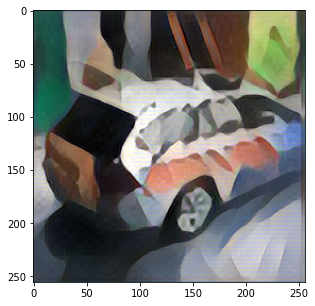

Saved sample stylized image at udnie/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	397816.72
	Style Loss:	236517.28
	Total Loss:	634333.52
Time elapsed:	4552.412184000015 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_18000.pth


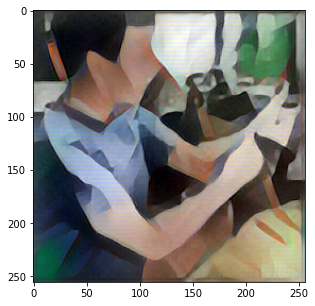

Saved sample stylized image at udnie/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	396641.28
	Style Loss:	233235.06
	Total Loss:	629875.79
Time elapsed:	4678.30272936821 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_18500.pth


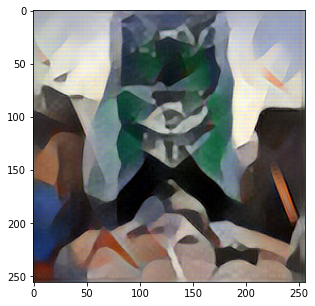

Saved sample stylized image at udnie/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	395988.41
	Style Loss:	230131.78
	Total Loss:	626119.43
Time elapsed:	4804.092159032822 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_19000.pth


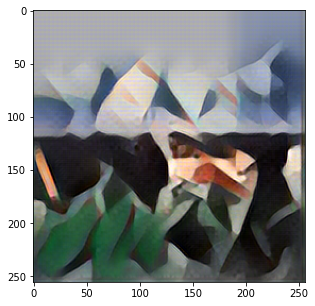

Saved sample stylized image at udnie/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	394837.81
	Style Loss:	227166.74
	Total Loss:	622003.87
Time elapsed:	4930.166174650192 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_19500.pth


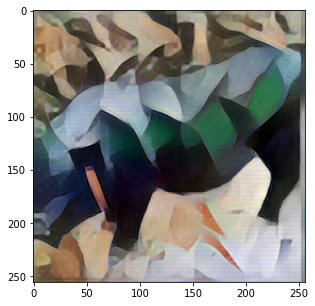

Saved sample stylized image at udnie/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	393982.38
	Style Loss:	224342.34
	Total Loss:	618324.28
Time elapsed:	5056.066543102264 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_20000.pth


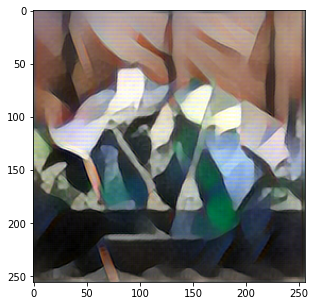

Saved sample stylized image at udnie/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	393187.00
	Style Loss:	221638.00
	Total Loss:	614824.61
Time elapsed:	5181.876133918762 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_20500.pth


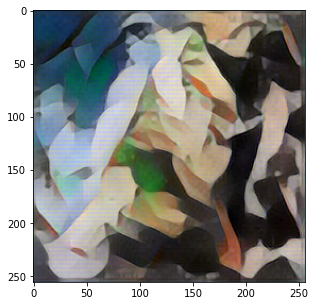

Saved sample stylized image at udnie/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	392586.50
	Style Loss:	219038.37
	Total Loss:	611624.36
Time elapsed:	5307.924291610718 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_21000.pth


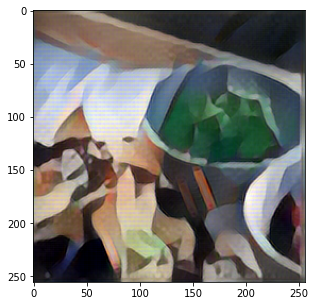

Saved sample stylized image at udnie/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	391967.47
	Style Loss:	216546.99
	Total Loss:	608514.04
Time elapsed:	5433.678581476212 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_21500.pth


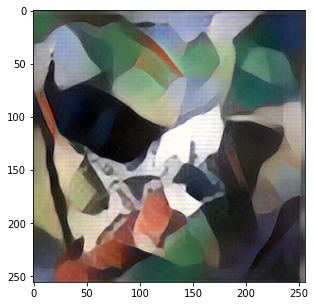

Saved sample stylized image at udnie/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	391053.72
	Style Loss:	214197.56
	Total Loss:	605250.90
Time elapsed:	5559.553801059723 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_22000.pth


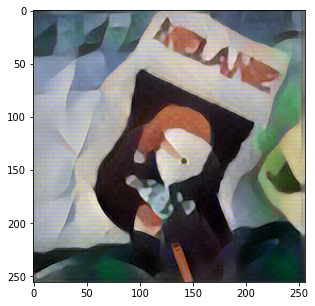

Saved sample stylized image at udnie/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	390200.47
	Style Loss:	211913.95
	Total Loss:	602113.70
Time elapsed:	5685.4063103199005 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_22500.pth


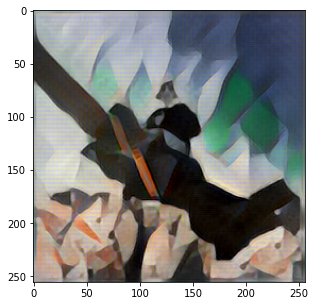

Saved sample stylized image at udnie/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	389714.88
	Style Loss:	209727.58
	Total Loss:	599441.82
Time elapsed:	5811.313182830811 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_23000.pth


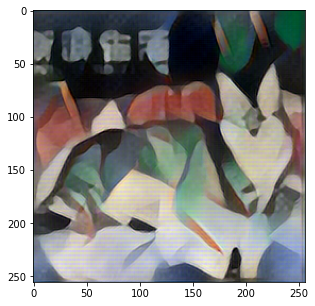

Saved sample stylized image at udnie/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	388787.19
	Style Loss:	207608.43
	Total Loss:	596394.86
Time elapsed:	5936.918102264404 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_23500.pth


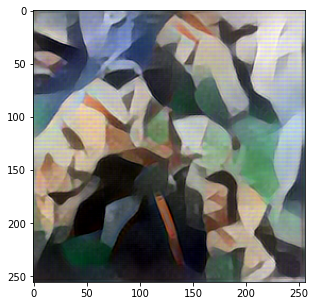

Saved sample stylized image at udnie/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	387948.56
	Style Loss:	205571.93
	Total Loss:	593519.62
Time elapsed:	6062.973812580109 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24000.pth


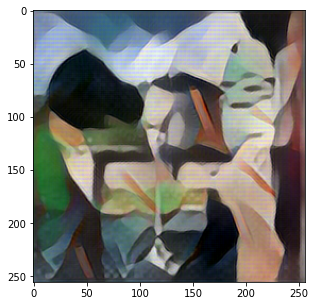

Saved sample stylized image at udnie/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	387526.97
	Style Loss:	203619.76
	Total Loss:	591145.61
Time elapsed:	6188.789857387543 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24500.pth


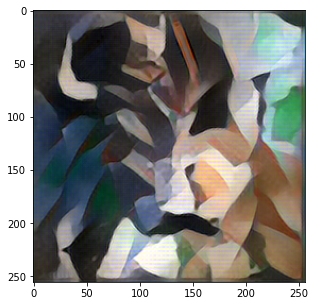

Saved sample stylized image at udnie/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	386908.94
	Style Loss:	201750.15
	Total Loss:	588657.69
Time elapsed:	6314.115085363388 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24999.pth


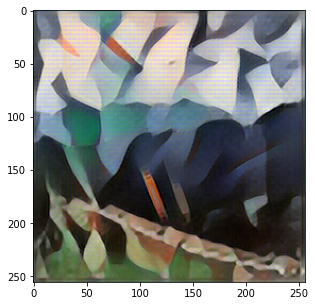

Saved sample stylized image at udnie/images/sample0_24999.png
Done Training the Network!
Training Time: 6314.33497095108 seconds
========Content Loss========
[20985430.0, 3234685.3808632735, 2128221.550387113, 1697267.5134077282, 1457506.3181690404, 1301434.456180028, 1193090.8408447185, 1112620.5245911882, 1050054.9482941765, 1001442.1721839592, 958029.9279331634, 922270.8887645428, 890985.2627843276, 864700.5586736656, 841824.0762971361, 821840.9922385348, 804138.2964512248, 787906.2886020762, 772418.5984821131, 758989.0562243448, 746818.6808537897, 735464.8615756832, 725053.7473780792, 715640.2408323189, 706377.7077899758, 698192.441562175, 690892.3277175794, 683525.0619907784, 676799.8177295371, 670391.6332860665, 664325.8935070995, 658512.7917896427, 653134.3395451846, 648025.6945052573, 643380.5173114816, 638525.7259995857, 634333.5158862702, 629875.792742622, 626119.4251355192, 622003.8653242141, 618324.2835655092, 614824.6142070814, 611624.3630161957, 608514.0377722257, 605250.

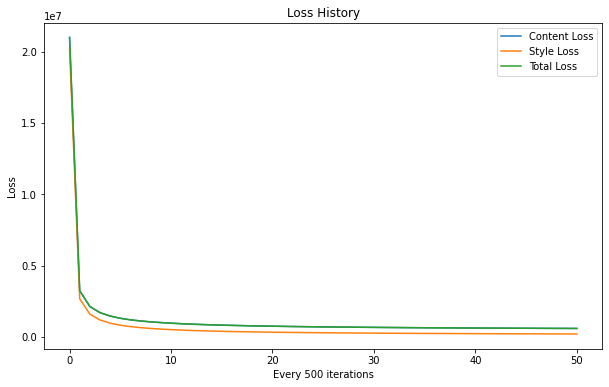

In [14]:
train()

In [15]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/udnie/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/udnie/

## Rain Princess

In [16]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/rain_princess.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "rain_princess/models/"
SAVE_IMAGE_PATH = "rain_princess/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

In [24]:
train()

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	20046210.00
	Total Loss:	20838444.00
Time elapsed:	0.6529982089996338 seconds


FileNotFoundError: ignored

In [18]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/rain_princess/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/rain_princess/

## The Scream

In [19]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_scream.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_scream/models/"
SAVE_IMAGE_PATH = "the_scream/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	25249180.00
	Total Loss:	26041414.00
Time elapsed:	0.4854116439819336 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_0.pth


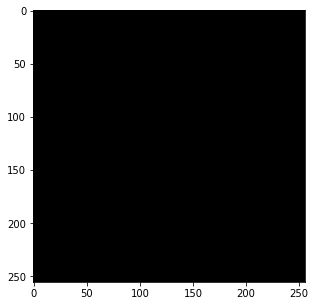

Saved sample stylized image at the_scream/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	636542.69
	Style Loss:	2257981.68
	Total Loss:	2894524.52
Time elapsed:	116.24525737762451 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_500.pth


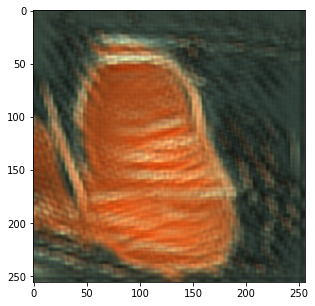

Saved sample stylized image at the_scream/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	610593.31
	Style Loss:	1266806.41
	Total Loss:	1877399.62
Time elapsed:	232.53494262695312 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_1000.pth


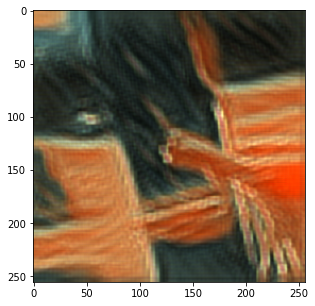

Saved sample stylized image at the_scream/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	595794.38
	Style Loss:	911444.50
	Total Loss:	1507238.22
Time elapsed:	348.83606362342834 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_1500.pth


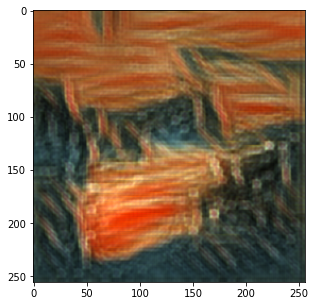

Saved sample stylized image at the_scream/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	584965.00
	Style Loss:	724842.83
	Total Loss:	1309807.43
Time elapsed:	465.58597469329834 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_2000.pth


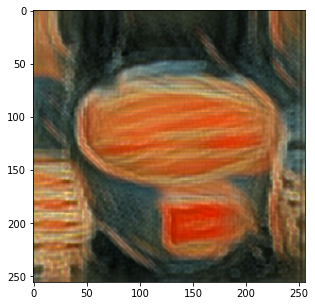

Saved sample stylized image at the_scream/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	574781.69
	Style Loss:	610383.20
	Total Loss:	1185164.99
Time elapsed:	582.2399997711182 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_2500.pth


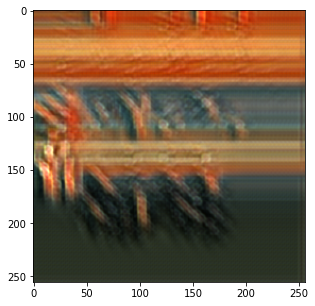

Saved sample stylized image at the_scream/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	567144.88
	Style Loss:	532404.10
	Total Loss:	1099549.22
Time elapsed:	698.6623423099518 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_3000.pth


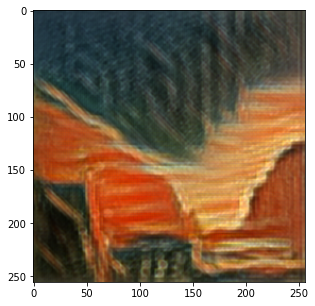

Saved sample stylized image at the_scream/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	560816.88
	Style Loss:	475547.54
	Total Loss:	1036364.55
Time elapsed:	815.3739013671875 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_3500.pth


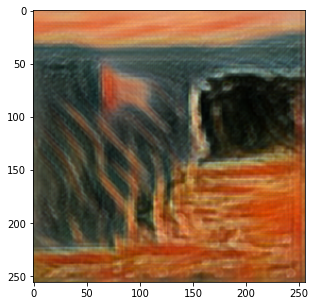

Saved sample stylized image at the_scream/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	556253.88
	Style Loss:	432061.88
	Total Loss:	988315.78
Time elapsed:	931.934597492218 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_4000.pth


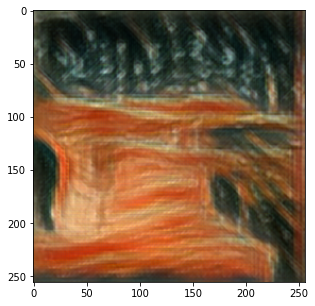

Saved sample stylized image at the_scream/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	553914.75
	Style Loss:	397898.46
	Total Loss:	951813.53
Time elapsed:	1048.4004714488983 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_4500.pth


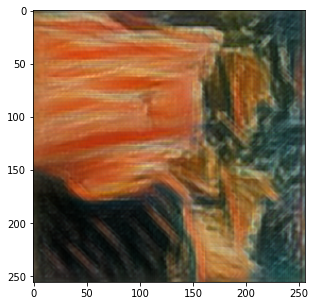

Saved sample stylized image at the_scream/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	547532.88
	Style Loss:	369749.25
	Total Loss:	917282.44
Time elapsed:	1164.9798152446747 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_5000.pth


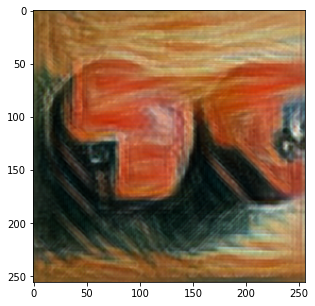

Saved sample stylized image at the_scream/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	544245.19
	Style Loss:	346500.70
	Total Loss:	890746.20
Time elapsed:	1281.5941681861877 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_5500.pth


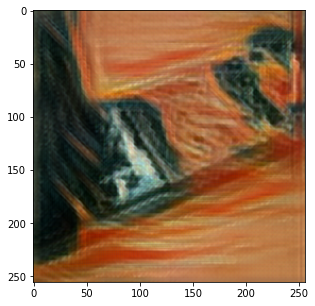

Saved sample stylized image at the_scream/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	540062.31
	Style Loss:	326676.31
	Total Loss:	866738.39
Time elapsed:	1397.9030227661133 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_6000.pth


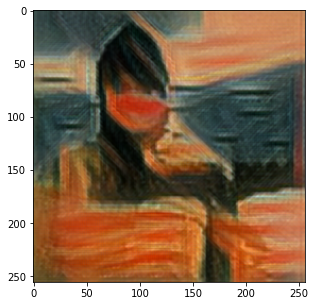

Saved sample stylized image at the_scream/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	537250.88
	Style Loss:	309787.89
	Total Loss:	847038.28
Time elapsed:	1514.424985408783 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_6500.pth


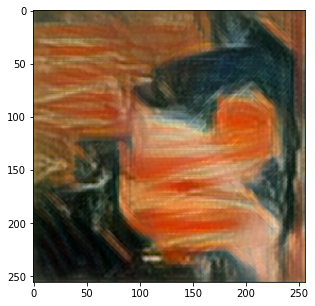

Saved sample stylized image at the_scream/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	534758.06
	Style Loss:	295128.02
	Total Loss:	829885.68
Time elapsed:	1631.099594593048 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_7000.pth


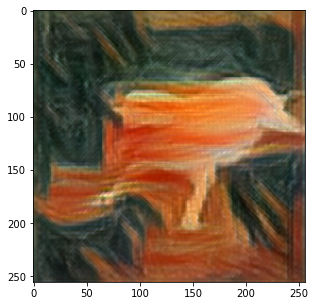

Saved sample stylized image at the_scream/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	532889.88
	Style Loss:	282310.18
	Total Loss:	815199.75
Time elapsed:	1747.5047714710236 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_7500.pth


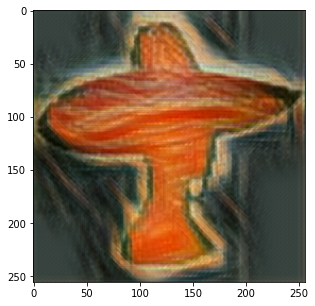

Saved sample stylized image at the_scream/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	531296.06
	Style Loss:	270937.69
	Total Loss:	802233.44
Time elapsed:	1864.2531111240387 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_8000.pth


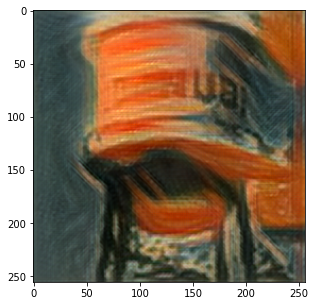

Saved sample stylized image at the_scream/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	529250.12
	Style Loss:	260862.58
	Total Loss:	790112.44
Time elapsed:	1980.9037466049194 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_8500.pth


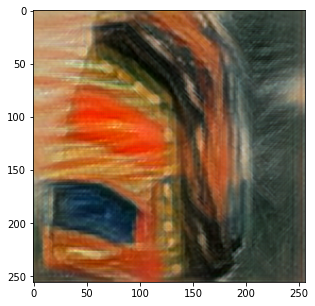

Saved sample stylized image at the_scream/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	526775.62
	Style Loss:	251649.19
	Total Loss:	778424.19
Time elapsed:	2097.563122034073 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_9000.pth


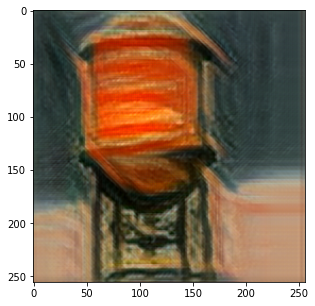

Saved sample stylized image at the_scream/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	525369.31
	Style Loss:	243419.59
	Total Loss:	768788.37
Time elapsed:	2214.119746685028 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_9500.pth


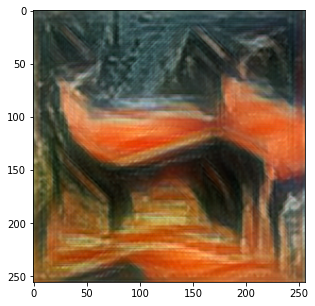

Saved sample stylized image at the_scream/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	523352.22
	Style Loss:	235951.12
	Total Loss:	759302.72
Time elapsed:	2330.776201248169 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_10000.pth


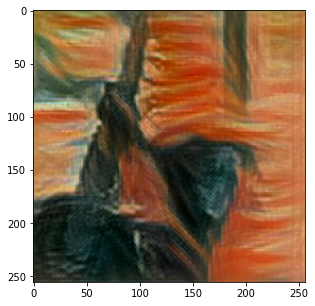

Saved sample stylized image at the_scream/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	521757.31
	Style Loss:	229150.91
	Total Loss:	750907.68
Time elapsed:	2447.4526557922363 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_10500.pth


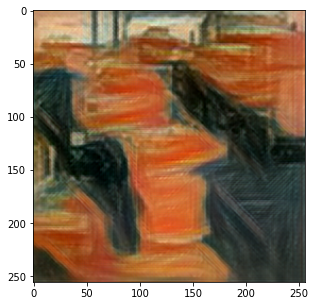

Saved sample stylized image at the_scream/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	520423.97
	Style Loss:	222973.57
	Total Loss:	743396.82
Time elapsed:	2563.997403383255 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_11000.pth


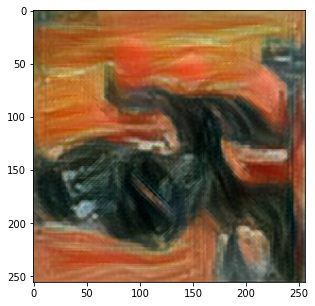

Saved sample stylized image at the_scream/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	519414.19
	Style Loss:	217234.57
	Total Loss:	736648.04
Time elapsed:	2680.7217938899994 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_11500.pth


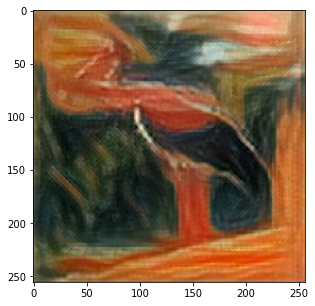

Saved sample stylized image at the_scream/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	518111.38
	Style Loss:	212017.09
	Total Loss:	730127.98
Time elapsed:	2797.4005241394043 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_12000.pth


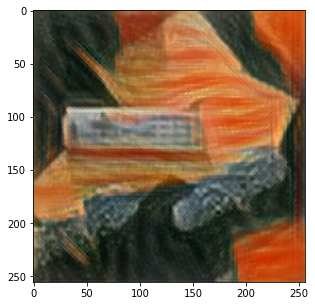

Saved sample stylized image at the_scream/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	517160.47
	Style Loss:	207150.55
	Total Loss:	724310.86
Time elapsed:	2913.843097448349 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_12500.pth


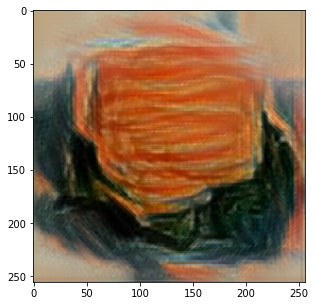

Saved sample stylized image at the_scream/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	516215.72
	Style Loss:	202639.72
	Total Loss:	718855.38
Time elapsed:	3030.1520874500275 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_13000.pth


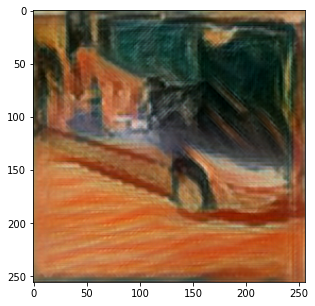

Saved sample stylized image at the_scream/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	515007.59
	Style Loss:	198388.76
	Total Loss:	713396.62
Time elapsed:	3146.8944578170776 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_13500.pth


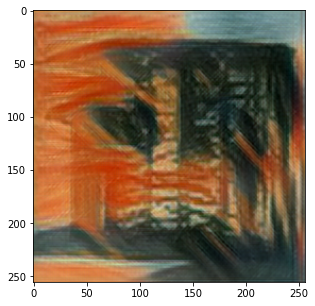

Saved sample stylized image at the_scream/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	514289.62
	Style Loss:	194448.77
	Total Loss:	708738.97
Time elapsed:	3263.5053989887238 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_14000.pth


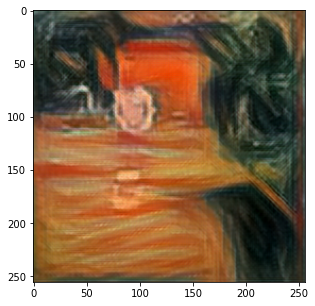

Saved sample stylized image at the_scream/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	512943.75
	Style Loss:	190735.96
	Total Loss:	703680.17
Time elapsed:	3380.0932846069336 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_14500.pth


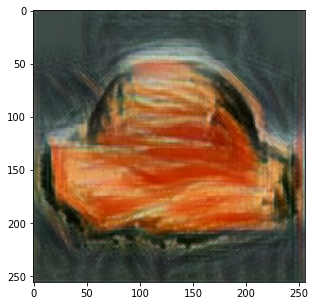

Saved sample stylized image at the_scream/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	511592.03
	Style Loss:	187269.86
	Total Loss:	698862.06
Time elapsed:	3496.780997276306 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_15000.pth


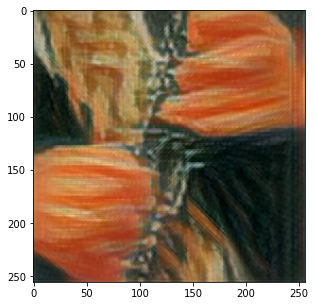

Saved sample stylized image at the_scream/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	510499.75
	Style Loss:	183982.90
	Total Loss:	694482.78
Time elapsed:	3613.2750322818756 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_15500.pth


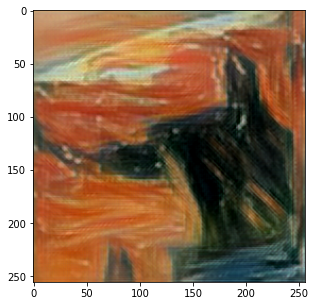

Saved sample stylized image at the_scream/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	509371.44
	Style Loss:	180876.42
	Total Loss:	690247.54
Time elapsed:	3729.7459156513214 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_16000.pth


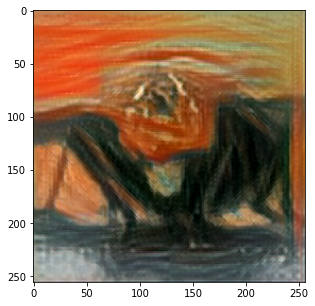

Saved sample stylized image at the_scream/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	508605.47
	Style Loss:	177977.45
	Total Loss:	686582.46
Time elapsed:	3846.553381204605 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_16500.pth


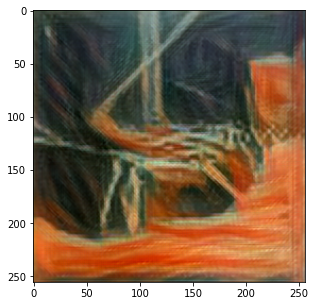

Saved sample stylized image at the_scream/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	507888.19
	Style Loss:	175248.82
	Total Loss:	683135.90
Time elapsed:	3963.37992978096 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_17000.pth


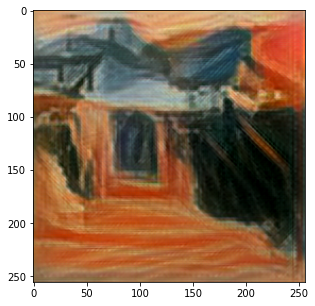

Saved sample stylized image at the_scream/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	506887.41
	Style Loss:	172646.88
	Total Loss:	679533.05
Time elapsed:	4079.8367664813995 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_17500.pth


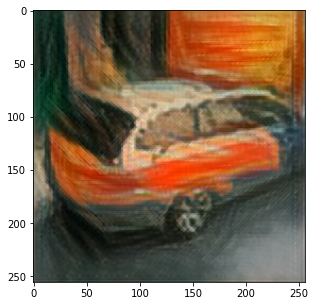

Saved sample stylized image at the_scream/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	506283.25
	Style Loss:	170199.78
	Total Loss:	676481.67
Time elapsed:	4196.5460295677185 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_18000.pth


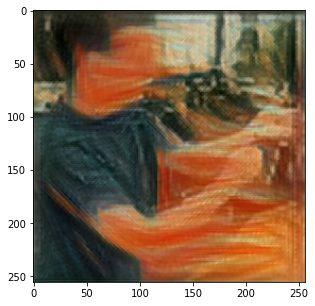

Saved sample stylized image at the_scream/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	505436.78
	Style Loss:	167843.05
	Total Loss:	673278.73
Time elapsed:	4312.9545702934265 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_18500.pth


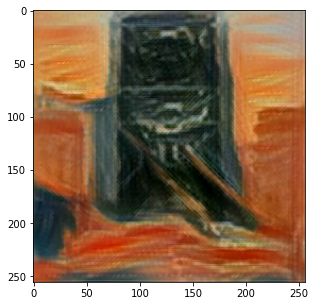

Saved sample stylized image at the_scream/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	504965.12
	Style Loss:	165610.34
	Total Loss:	670574.40
Time elapsed:	4429.309684514999 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_19000.pth


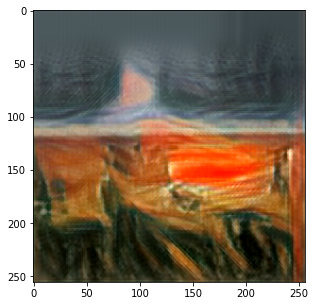

Saved sample stylized image at the_scream/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	504116.34
	Style Loss:	163485.63
	Total Loss:	667600.82
Time elapsed:	4545.534107923508 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_19500.pth


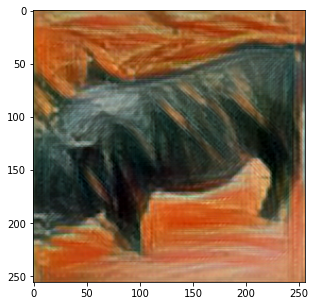

Saved sample stylized image at the_scream/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	503311.62
	Style Loss:	161454.95
	Total Loss:	664765.60
Time elapsed:	4661.848759889603 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_20000.pth


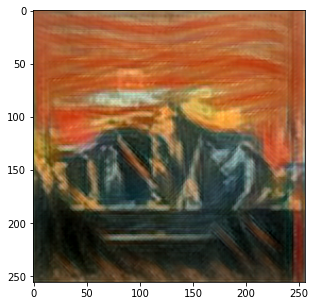

Saved sample stylized image at the_scream/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	502855.62
	Style Loss:	159522.20
	Total Loss:	662376.29
Time elapsed:	4778.092718601227 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_20500.pth


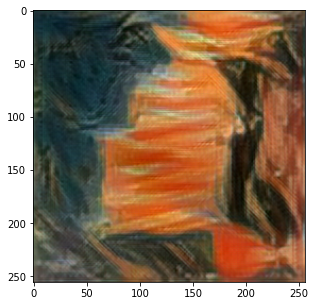

Saved sample stylized image at the_scream/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	502472.81
	Style Loss:	157660.53
	Total Loss:	660132.06
Time elapsed:	4894.416786432266 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_21000.pth


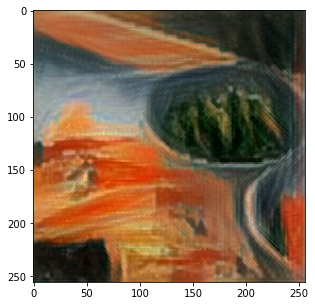

Saved sample stylized image at the_scream/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	502014.16
	Style Loss:	155869.07
	Total Loss:	657881.90
Time elapsed:	5010.63153219223 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_21500.pth


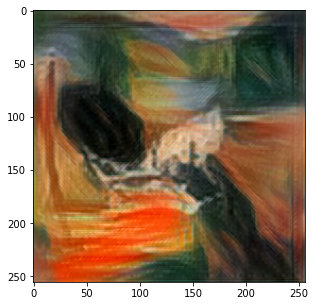

Saved sample stylized image at the_scream/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	501289.25
	Style Loss:	154177.13
	Total Loss:	655465.04
Time elapsed:	5126.93962097168 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_22000.pth


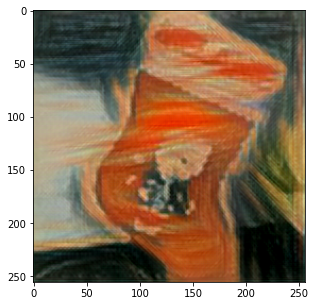

Saved sample stylized image at the_scream/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	500679.31
	Style Loss:	152540.81
	Total Loss:	653219.00
Time elapsed:	5243.098248720169 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_22500.pth


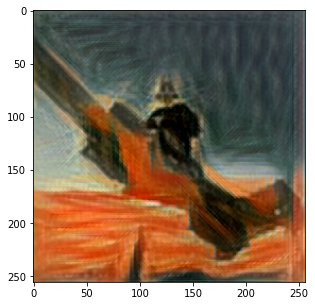

Saved sample stylized image at the_scream/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	500273.62
	Style Loss:	151002.94
	Total Loss:	651275.56
Time elapsed:	5359.3679740428925 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_23000.pth


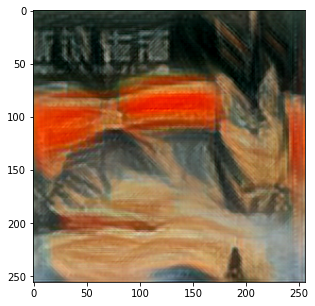

Saved sample stylized image at the_scream/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	499411.97
	Style Loss:	149472.04
	Total Loss:	648883.19
Time elapsed:	5475.648470878601 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_23500.pth


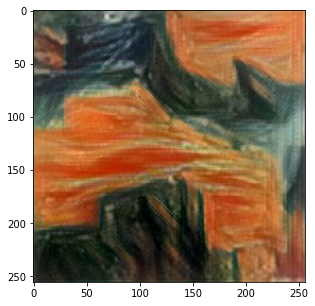

Saved sample stylized image at the_scream/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	498722.19
	Style Loss:	148023.56
	Total Loss:	646744.77
Time elapsed:	5592.004615783691 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_24000.pth


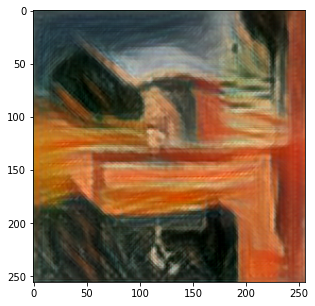

Saved sample stylized image at the_scream/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	498530.16
	Style Loss:	146650.92
	Total Loss:	645180.27
Time elapsed:	5708.124771595001 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_24500.pth


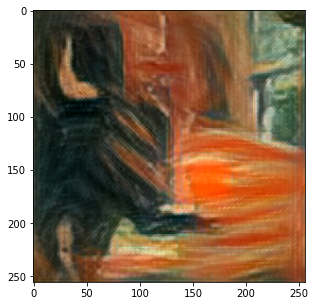

Saved sample stylized image at the_scream/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	497944.72
	Style Loss:	145306.27
	Total Loss:	643250.34
Time elapsed:	5824.268809080124 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_24999.pth


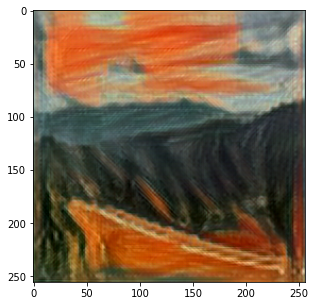

Saved sample stylized image at the_scream/images/sample0_24999.png
Done Training the Network!
Training Time: 5824.469038724899 seconds
========Content Loss========
[26041414.0, 2894524.521457086, 1877399.6176948051, 1507238.2166264157, 1309807.4253966766, 1185164.9863429628, 1099549.2220718095, 1036364.5511371751, 988315.7758372907, 951813.534138247, 917282.4395433413, 890746.1990319942, 866738.3878988918, 847038.2772361945, 829885.6790458506, 815199.7526579789, 802233.4383787964, 790112.4390182038, 778424.1934958616, 768788.372651563, 759302.7227183532, 750907.6764445053, 743396.8222036633, 736648.0425343448, 730127.9753796558, 724310.8640208783, 718855.3754927506, 713396.6158733612, 708738.9653283694, 703680.1664195573, 698862.0562879142, 694482.7807056803, 690247.5445089369, 686582.4591217956, 683135.9004231369, 679533.0452152734, 676481.6742038637, 673278.7273475082, 670574.40338173, 667600.822738257, 664765.5983669567, 662376.2908806278, 660132.0618943741, 657881.9015743454, 65546

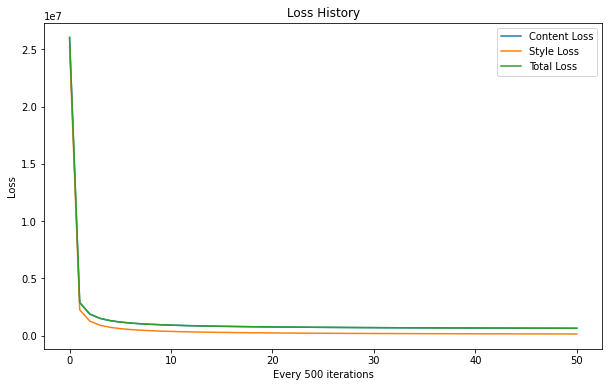

In [20]:
train()

In [21]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_scream/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_scream/

## The Shipwreck

In [25]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_shipwreck.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_shipwreck/models/"
SAVE_IMAGE_PATH = "the_shipwreck/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	20046214.00
	Total Loss:	20838448.00
Time elapsed:	0.6665465831756592 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_0.pth


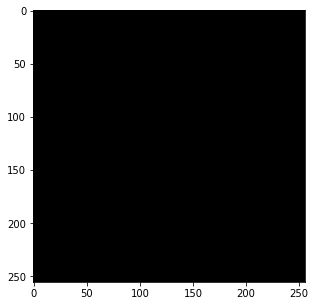

Saved sample stylized image at the_shipwreck/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	564946.88
	Style Loss:	1697692.05
	Total Loss:	2262638.75
Time elapsed:	112.59261798858643 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_500.pth


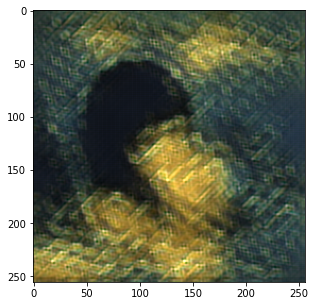

Saved sample stylized image at the_shipwreck/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	533156.69
	Style Loss:	949611.88
	Total Loss:	1482768.27
Time elapsed:	228.93013978004456 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_1000.pth


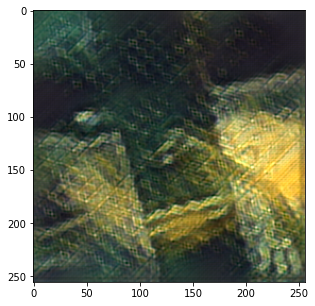

Saved sample stylized image at the_shipwreck/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	514582.75
	Style Loss:	684142.84
	Total Loss:	1198725.33
Time elapsed:	346.87648367881775 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_1500.pth


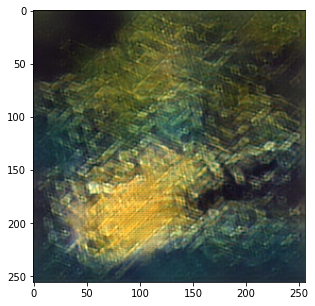

Saved sample stylized image at the_shipwreck/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	500640.56
	Style Loss:	546671.09
	Total Loss:	1047311.35
Time elapsed:	464.9789698123932 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_2000.pth


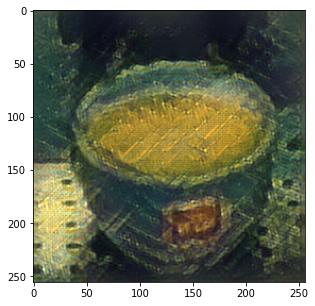

Saved sample stylized image at the_shipwreck/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	488970.53
	Style Loss:	461960.90
	Total Loss:	950931.57
Time elapsed:	583.7865188121796 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_2500.pth


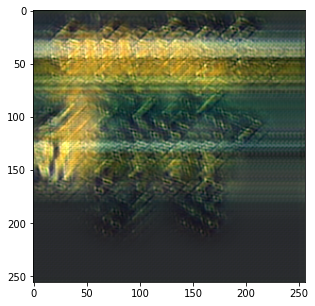

Saved sample stylized image at the_shipwreck/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	480385.28
	Style Loss:	403830.81
	Total Loss:	884216.48
Time elapsed:	702.1548824310303 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_3000.pth


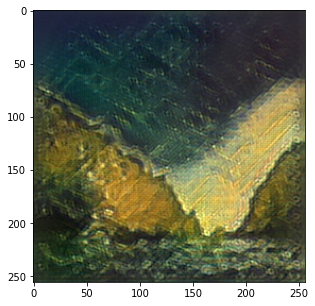

Saved sample stylized image at the_shipwreck/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	474442.50
	Style Loss:	361492.72
	Total Loss:	835935.84
Time elapsed:	820.9171814918518 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_3500.pth


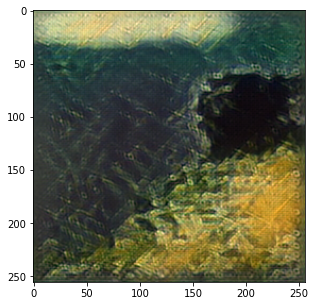

Saved sample stylized image at the_shipwreck/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	469894.78
	Style Loss:	328907.85
	Total Loss:	798803.34
Time elapsed:	939.4586896896362 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_4000.pth


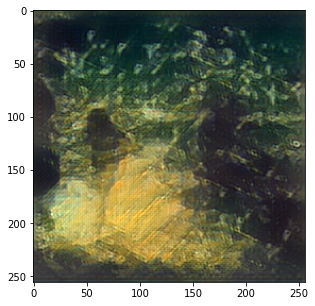

Saved sample stylized image at the_shipwreck/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	467582.97
	Style Loss:	303333.00
	Total Loss:	770916.92
Time elapsed:	1058.1454837322235 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_4500.pth


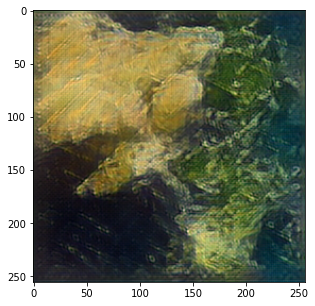

Saved sample stylized image at the_shipwreck/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	462053.53
	Style Loss:	282531.68
	Total Loss:	744586.34
Time elapsed:	1176.246920824051 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_5000.pth


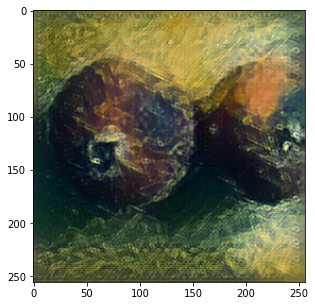

Saved sample stylized image at the_shipwreck/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	458464.03
	Style Loss:	265192.00
	Total Loss:	723657.11
Time elapsed:	1294.7721033096313 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_5500.pth


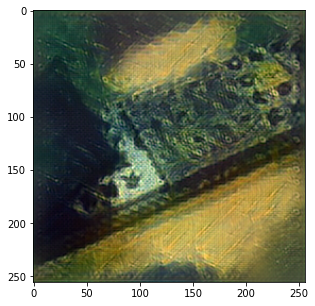

Saved sample stylized image at the_shipwreck/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	454258.56
	Style Loss:	250538.03
	Total Loss:	704797.90
Time elapsed:	1413.0936069488525 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_6000.pth


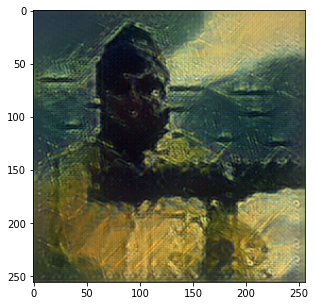

Saved sample stylized image at the_shipwreck/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	451590.06
	Style Loss:	238075.85
	Total Loss:	689667.01
Time elapsed:	1531.619876384735 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_6500.pth


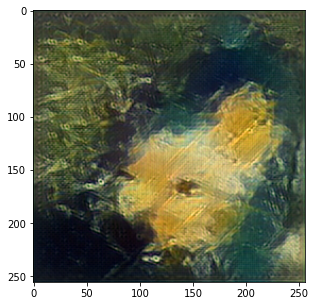

Saved sample stylized image at the_shipwreck/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	449103.31
	Style Loss:	227245.06
	Total Loss:	676349.60
Time elapsed:	1649.7160153388977 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_7000.pth


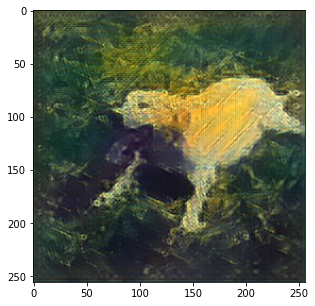

Saved sample stylized image at the_shipwreck/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	447256.00
	Style Loss:	217741.01
	Total Loss:	664998.00
Time elapsed:	1768.28733086586 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_7500.pth


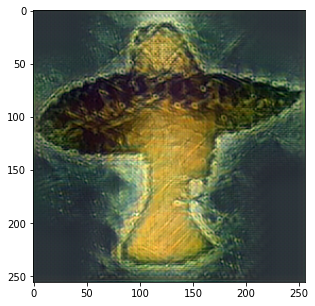

Saved sample stylized image at the_shipwreck/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	445706.81
	Style Loss:	209336.04
	Total Loss:	655043.77
Time elapsed:	1886.5728487968445 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_8000.pth


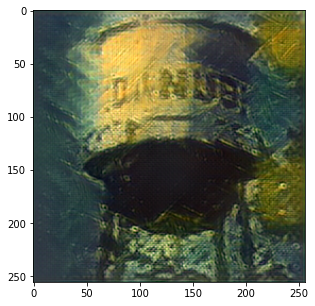

Saved sample stylized image at the_shipwreck/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	443805.69
	Style Loss:	201877.38
	Total Loss:	645683.80
Time elapsed:	2000.6339037418365 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_8500.pth


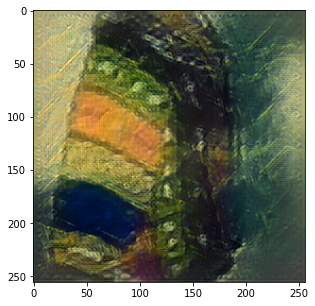

Saved sample stylized image at the_shipwreck/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	441233.03
	Style Loss:	195161.42
	Total Loss:	636395.41
Time elapsed:	2114.721067428589 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_9000.pth


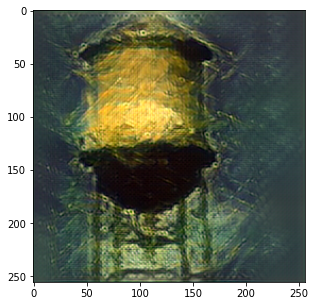

Saved sample stylized image at the_shipwreck/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	439595.28
	Style Loss:	189078.66
	Total Loss:	628674.85
Time elapsed:	2228.884370326996 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_9500.pth


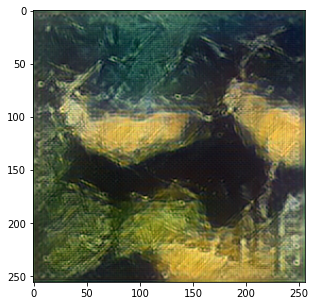

Saved sample stylized image at the_shipwreck/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	437900.88
	Style Loss:	183581.93
	Total Loss:	621483.15
Time elapsed:	2343.0681612491608 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_10000.pth


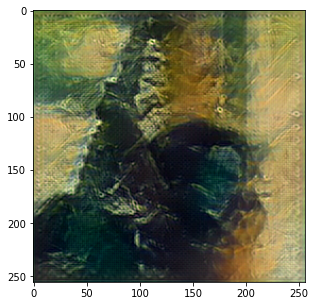

Saved sample stylized image at the_shipwreck/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	436337.03
	Style Loss:	178604.71
	Total Loss:	614942.21
Time elapsed:	2457.127782344818 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_10500.pth


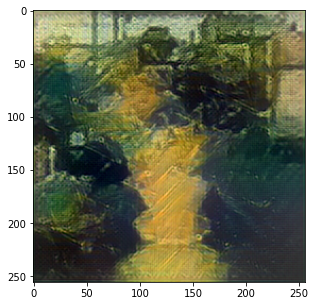

Saved sample stylized image at the_shipwreck/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	434887.69
	Style Loss:	174034.32
	Total Loss:	608922.45
Time elapsed:	2571.5385620594025 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_11000.pth


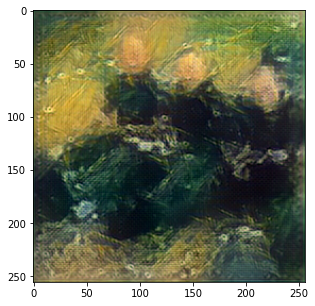

Saved sample stylized image at the_shipwreck/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	433802.22
	Style Loss:	169865.39
	Total Loss:	603667.82
Time elapsed:	2685.8594756126404 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_11500.pth


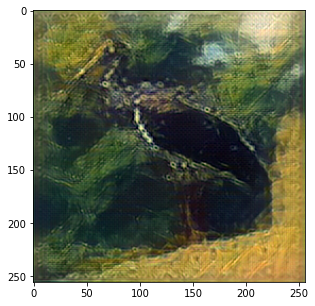

Saved sample stylized image at the_shipwreck/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	432241.03
	Style Loss:	165992.23
	Total Loss:	598233.43
Time elapsed:	2799.831979036331 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_12000.pth


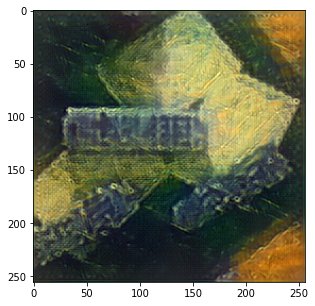

Saved sample stylized image at the_shipwreck/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	431219.75
	Style Loss:	162455.43
	Total Loss:	593675.31
Time elapsed:	2914.109662771225 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_12500.pth


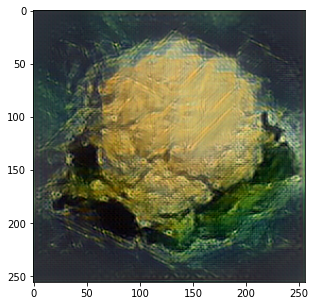

Saved sample stylized image at the_shipwreck/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	430432.12
	Style Loss:	159188.08
	Total Loss:	589620.25
Time elapsed:	3028.4805533885956 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_13000.pth


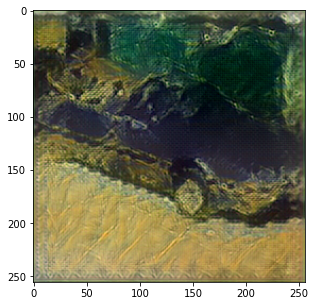

Saved sample stylized image at the_shipwreck/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	429223.16
	Style Loss:	156076.90
	Total Loss:	585300.24
Time elapsed:	3142.5452704429626 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_13500.pth


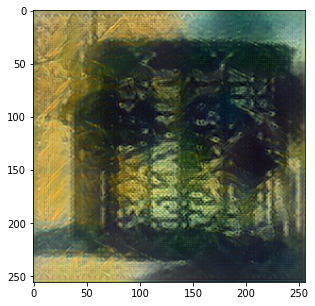

Saved sample stylized image at the_shipwreck/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	428348.84
	Style Loss:	153165.20
	Total Loss:	581514.23
Time elapsed:	3256.496626138687 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_14000.pth


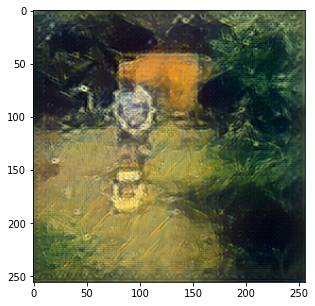

Saved sample stylized image at the_shipwreck/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	427347.06
	Style Loss:	150513.23
	Total Loss:	577860.39
Time elapsed:	3370.7472100257874 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_14500.pth


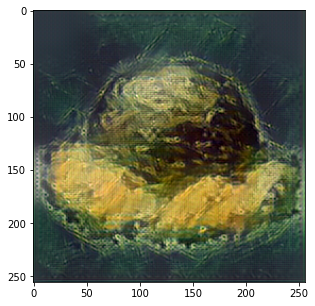

Saved sample stylized image at the_shipwreck/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	426191.84
	Style Loss:	148026.63
	Total Loss:	574218.80
Time elapsed:	3484.888331413269 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_15000.pth


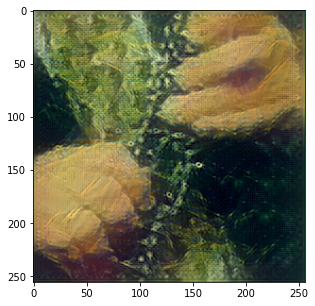

Saved sample stylized image at the_shipwreck/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	425132.81
	Style Loss:	145592.17
	Total Loss:	570725.14
Time elapsed:	3598.8975784778595 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_15500.pth


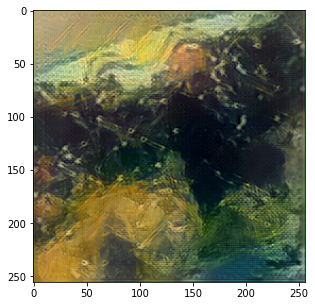

Saved sample stylized image at the_shipwreck/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	424179.16
	Style Loss:	143313.48
	Total Loss:	567493.12
Time elapsed:	3713.0909521579742 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_16000.pth


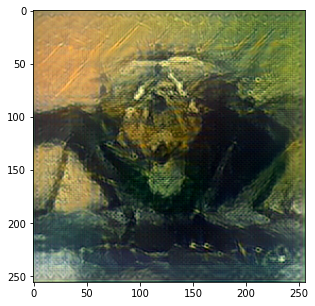

Saved sample stylized image at the_shipwreck/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	423449.03
	Style Loss:	141190.50
	Total Loss:	564640.02
Time elapsed:	3827.508691072464 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_16500.pth


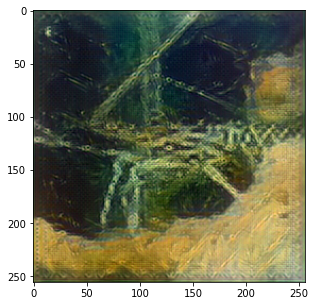

Saved sample stylized image at the_shipwreck/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	422772.94
	Style Loss:	139164.48
	Total Loss:	561937.69
Time elapsed:	3941.623795747757 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_17000.pth


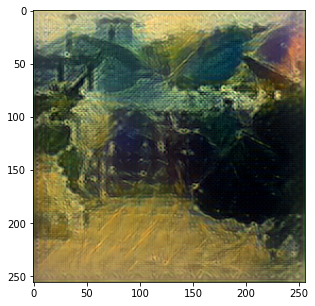

Saved sample stylized image at the_shipwreck/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	421806.59
	Style Loss:	137269.02
	Total Loss:	559076.28
Time elapsed:	4055.9600863456726 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_17500.pth


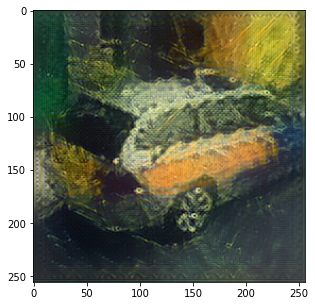

Saved sample stylized image at the_shipwreck/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	421154.25
	Style Loss:	135522.98
	Total Loss:	556678.11
Time elapsed:	4170.484627485275 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_18000.pth


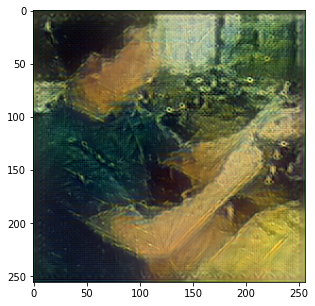

Saved sample stylized image at the_shipwreck/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	420191.88
	Style Loss:	133786.15
	Total Loss:	553979.34
Time elapsed:	4284.688133716583 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_18500.pth


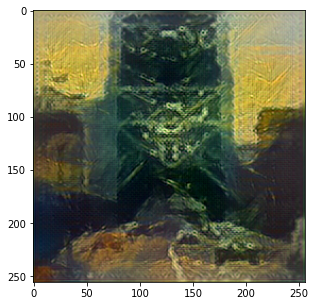

Saved sample stylized image at the_shipwreck/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	419723.22
	Style Loss:	132144.84
	Total Loss:	551869.03
Time elapsed:	4398.92152094841 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_19000.pth


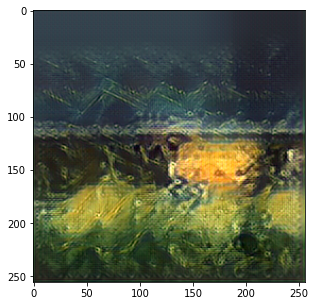

Saved sample stylized image at the_shipwreck/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	418809.91
	Style Loss:	130576.34
	Total Loss:	549387.01
Time elapsed:	4513.242015361786 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_19500.pth


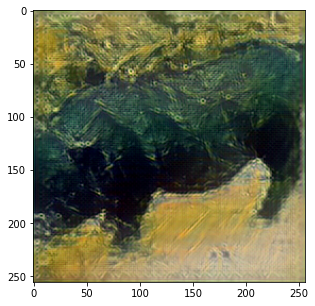

Saved sample stylized image at the_shipwreck/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	418191.25
	Style Loss:	129086.23
	Total Loss:	547278.38
Time elapsed:	4627.603847742081 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_20000.pth


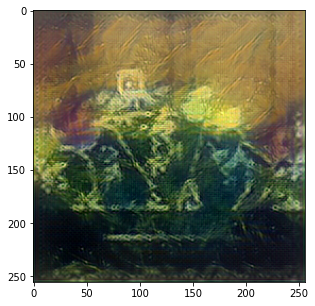

Saved sample stylized image at the_shipwreck/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	417574.59
	Style Loss:	127655.01
	Total Loss:	545230.42
Time elapsed:	4741.687577724457 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_20500.pth


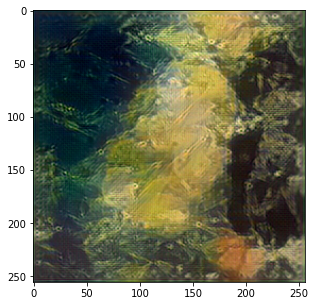

Saved sample stylized image at the_shipwreck/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	417108.75
	Style Loss:	126294.62
	Total Loss:	543404.32
Time elapsed:	4855.998868942261 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_21000.pth


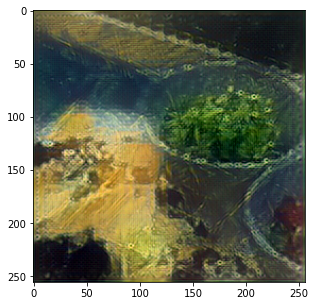

Saved sample stylized image at the_shipwreck/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	416636.62
	Style Loss:	124985.85
	Total Loss:	541623.79
Time elapsed:	4970.439670562744 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_21500.pth


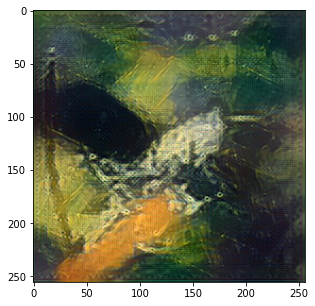

Saved sample stylized image at the_shipwreck/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	415888.66
	Style Loss:	123742.86
	Total Loss:	539633.05
Time elapsed:	5084.587871789932 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_22000.pth


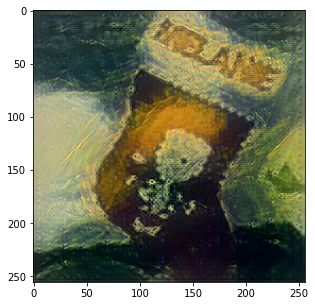

Saved sample stylized image at the_shipwreck/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	415261.59
	Style Loss:	122539.99
	Total Loss:	537803.25
Time elapsed:	5198.587079048157 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_22500.pth


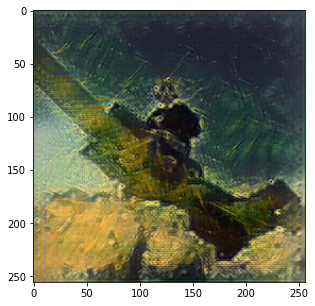

Saved sample stylized image at the_shipwreck/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	414948.09
	Style Loss:	121412.99
	Total Loss:	536362.12
Time elapsed:	5312.914194822311 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_23000.pth


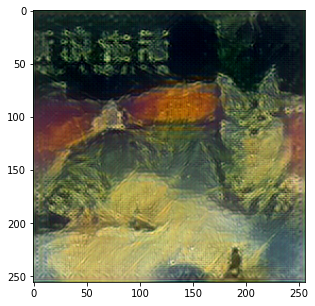

Saved sample stylized image at the_shipwreck/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	414063.34
	Style Loss:	120294.67
	Total Loss:	534359.22
Time elapsed:	5427.04271531105 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_23500.pth


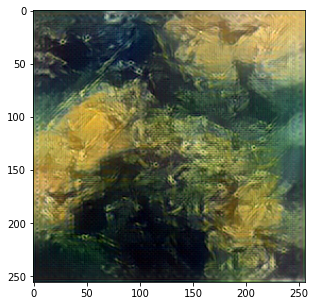

Saved sample stylized image at the_shipwreck/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	413374.31
	Style Loss:	119235.23
	Total Loss:	532610.54
Time elapsed:	5541.124445199966 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24000.pth


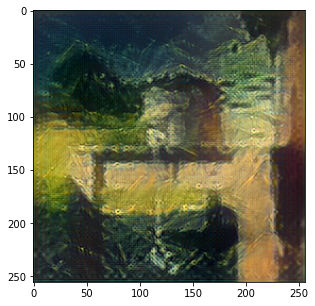

Saved sample stylized image at the_shipwreck/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	413107.31
	Style Loss:	118229.57
	Total Loss:	531338.04
Time elapsed:	5655.516849756241 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24500.pth


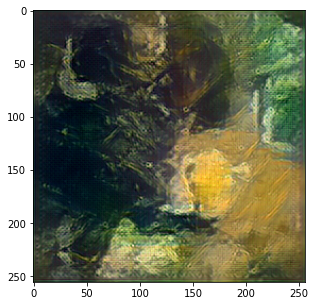

Saved sample stylized image at the_shipwreck/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	412573.72
	Style Loss:	117252.93
	Total Loss:	529827.68
Time elapsed:	5769.654873847961 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24999.pth


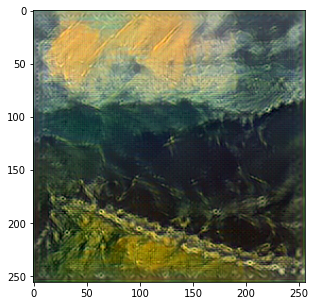

Saved sample stylized image at the_shipwreck/images/sample0_24999.png
Done Training the Network!
Training Time: 5769.869368314743 seconds
========Content Loss========
[20838448.0, 2262638.753243513, 1482768.2656406094, 1198725.3294678547, 1047311.3477323838, 950931.574782587, 884216.4837241753, 835935.8377427878, 798803.3446560235, 770916.9163727505, 744586.3389009698, 723657.1130987548, 704797.8951893435, 689667.011296339, 676349.5984814669, 664998.0026288162, 655043.76574022, 645683.7958585755, 636395.4136727863, 628674.8485718608, 621483.1548282672, 614942.213818922, 608922.4507544768, 603667.8158882923, 598233.4302948712, 593675.3127474802, 589620.2504903469, 585300.242192708, 581514.2264347189, 577860.3913738708, 574218.7961719219, 570725.1434363106, 567493.1186703175, 564640.0236330373, 561937.6943286425, 559076.2769752443, 556678.1099192406, 553979.3380813875, 551869.0281169412, 549387.0143197784, 547278.3771811409, 545230.4235799473, 543404.3188955288, 541623.7909399563, 539633

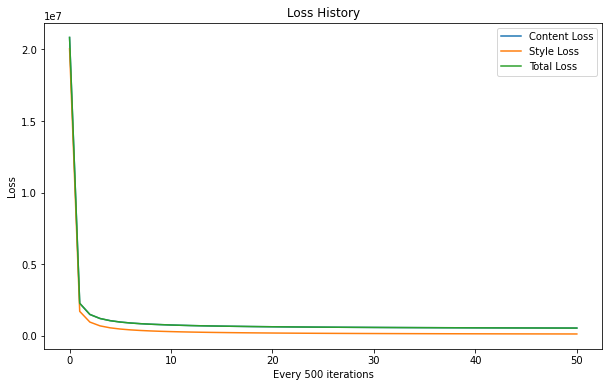

In [26]:
train()

In [27]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_shipwreck/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_shipwreck/

## Wave

In [28]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/wave.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "wave/models/"
SAVE_IMAGE_PATH = "wave/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	38423528.00
	Total Loss:	39215764.00
Time elapsed:	0.5671226978302002 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_0.pth


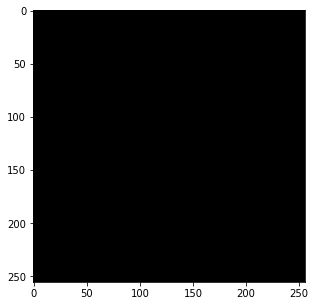

Saved sample stylized image at wave/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	675586.75
	Style Loss:	5712441.29
	Total Loss:	6388028.15
Time elapsed:	114.7914309501648 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_500.pth


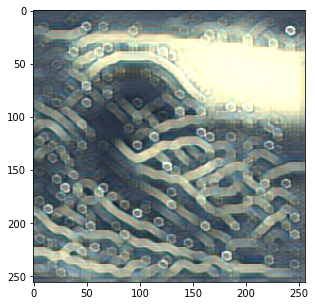

Saved sample stylized image at wave/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	655762.00
	Style Loss:	3182649.93
	Total Loss:	3838412.61
Time elapsed:	228.50487613677979 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_1000.pth


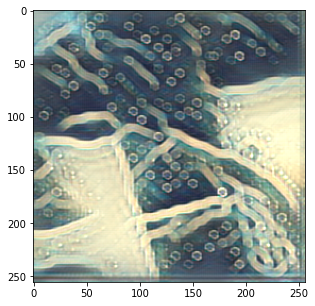

Saved sample stylized image at wave/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	641285.06
	Style Loss:	2271559.88
	Total Loss:	2912845.39
Time elapsed:	343.2186748981476 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_1500.pth


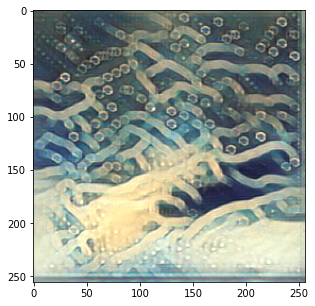

Saved sample stylized image at wave/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	629304.19
	Style Loss:	1792953.99
	Total Loss:	2422258.46
Time elapsed:	457.3798460960388 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_2000.pth


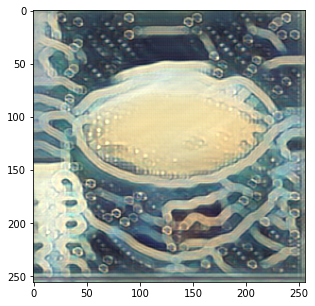

Saved sample stylized image at wave/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	617444.44
	Style Loss:	1493705.69
	Total Loss:	2111150.38
Time elapsed:	572.0345070362091 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_2500.pth


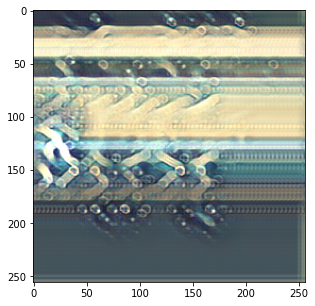

Saved sample stylized image at wave/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	608481.62
	Style Loss:	1289847.70
	Total Loss:	1898329.35
Time elapsed:	685.9258584976196 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_3000.pth


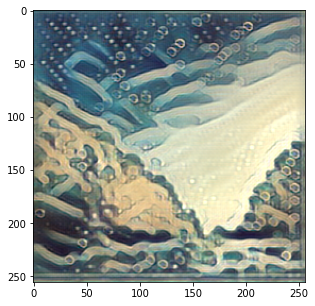

Saved sample stylized image at wave/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	600723.00
	Style Loss:	1138653.66
	Total Loss:	1739376.50
Time elapsed:	800.8486115932465 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_3500.pth


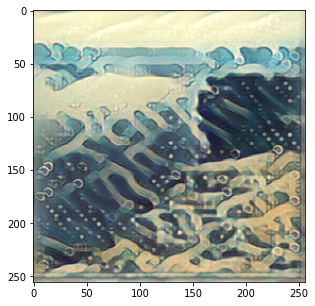

Saved sample stylized image at wave/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	594109.38
	Style Loss:	1022858.55
	Total Loss:	1616967.09
Time elapsed:	915.1271469593048 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_4000.pth


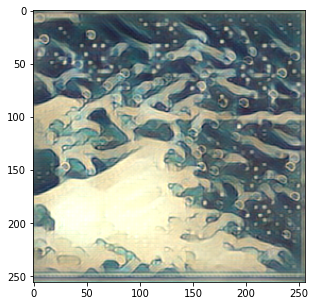

Saved sample stylized image at wave/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	589855.06
	Style Loss:	932268.29
	Total Loss:	1522122.66
Time elapsed:	1029.7491080760956 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_4500.pth


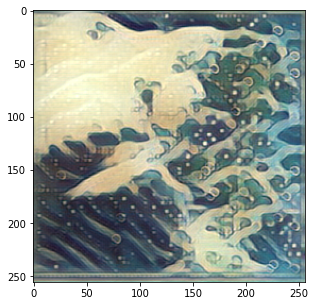

Saved sample stylized image at wave/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	583373.50
	Style Loss:	858258.66
	Total Loss:	1441631.74
Time elapsed:	1143.9819753170013 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_5000.pth


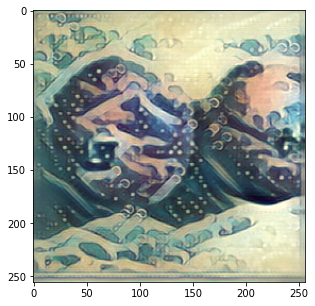

Saved sample stylized image at wave/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	578316.25
	Style Loss:	796665.68
	Total Loss:	1374981.33
Time elapsed:	1258.7939791679382 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_5500.pth


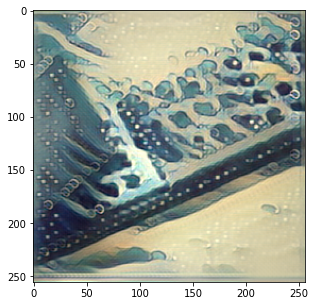

Saved sample stylized image at wave/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	573206.88
	Style Loss:	745101.77
	Total Loss:	1318307.88
Time elapsed:	1372.730634212494 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_6000.pth


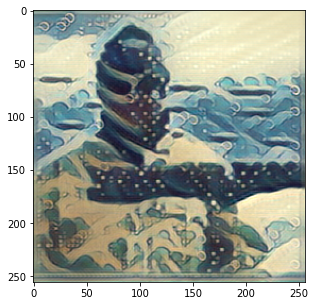

Saved sample stylized image at wave/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	569071.75
	Style Loss:	701061.70
	Total Loss:	1270132.38
Time elapsed:	1487.4530682563782 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_6500.pth


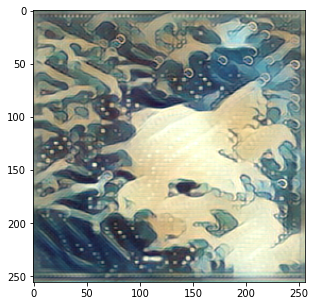

Saved sample stylized image at wave/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	565653.62
	Style Loss:	662877.97
	Total Loss:	1228530.69
Time elapsed:	1601.7893025875092 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_7000.pth


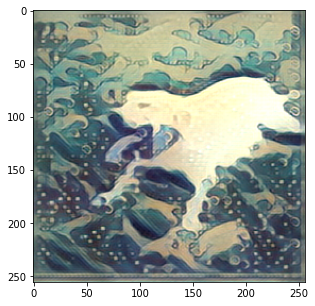

Saved sample stylized image at wave/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	562682.81
	Style Loss:	629522.19
	Total Loss:	1192204.12
Time elapsed:	1716.546138048172 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_7500.pth


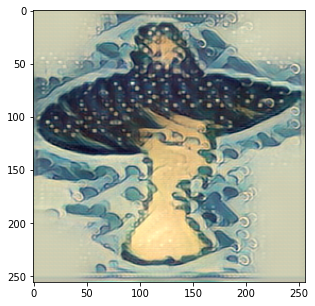

Saved sample stylized image at wave/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	560135.62
	Style Loss:	600095.72
	Total Loss:	1160230.69
Time elapsed:	1830.5435769557953 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_8000.pth


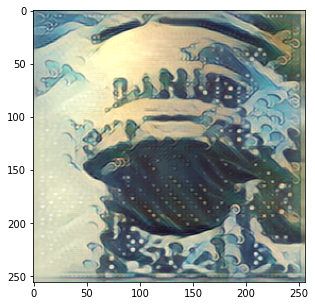

Saved sample stylized image at wave/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	557390.00
	Style Loss:	573997.67
	Total Loss:	1131386.64
Time elapsed:	1945.4900388717651 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_8500.pth


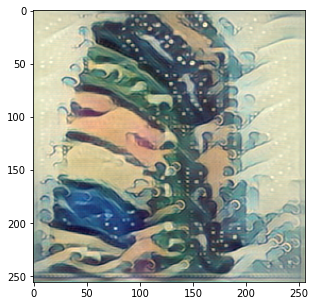

Saved sample stylized image at wave/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	554027.25
	Style Loss:	550525.17
	Total Loss:	1104551.33
Time elapsed:	2059.6604499816895 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_9000.pth


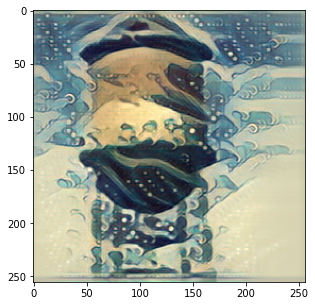

Saved sample stylized image at wave/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	551355.62
	Style Loss:	529378.12
	Total Loss:	1080732.62
Time elapsed:	2174.3594086170197 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_9500.pth


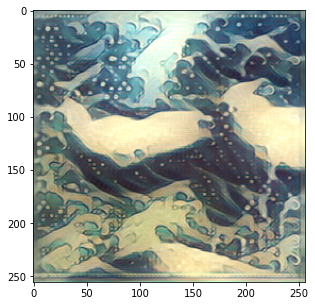

Saved sample stylized image at wave/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	549160.19
	Style Loss:	510219.82
	Total Loss:	1059379.75
Time elapsed:	2288.4872007369995 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_10000.pth


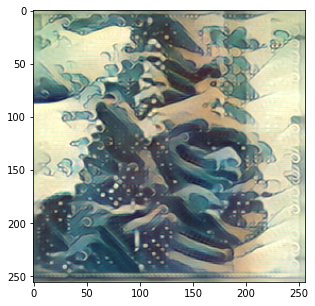

Saved sample stylized image at wave/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	546867.75
	Style Loss:	492776.72
	Total Loss:	1039644.23
Time elapsed:	2403.26091504097 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_10500.pth


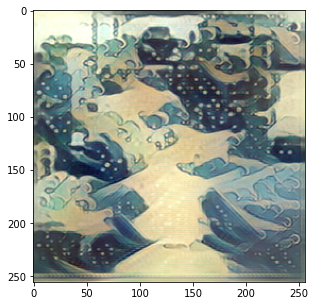

Saved sample stylized image at wave/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	544684.62
	Style Loss:	476881.89
	Total Loss:	1021566.37
Time elapsed:	2517.623311281204 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_11000.pth


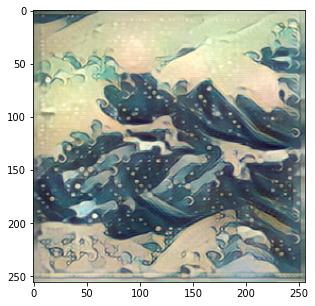

Saved sample stylized image at wave/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	542826.62
	Style Loss:	462278.44
	Total Loss:	1005104.86
Time elapsed:	2632.2171981334686 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_11500.pth


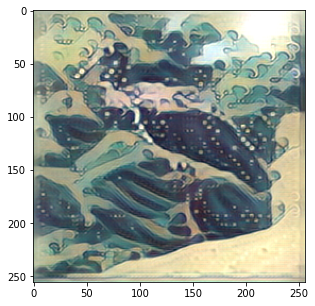

Saved sample stylized image at wave/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	540575.62
	Style Loss:	448904.35
	Total Loss:	989479.45
Time elapsed:	2746.1513390541077 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_12000.pth


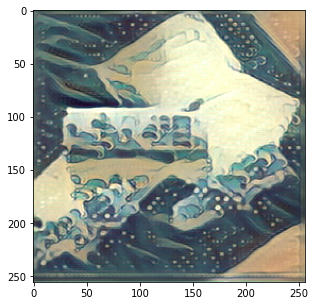

Saved sample stylized image at wave/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	538909.62
	Style Loss:	436535.94
	Total Loss:	975445.08
Time elapsed:	2861.0826041698456 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_12500.pth


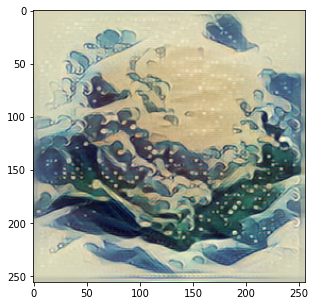

Saved sample stylized image at wave/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	537695.81
	Style Loss:	425092.11
	Total Loss:	962787.69
Time elapsed:	2975.3045570850372 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_13000.pth


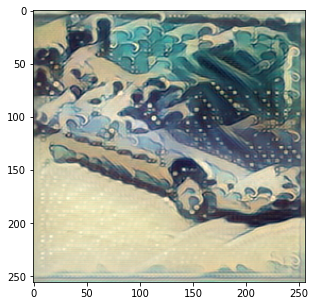

Saved sample stylized image at wave/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	535966.56
	Style Loss:	414380.40
	Total Loss:	950346.82
Time elapsed:	3089.983471632004 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_13500.pth


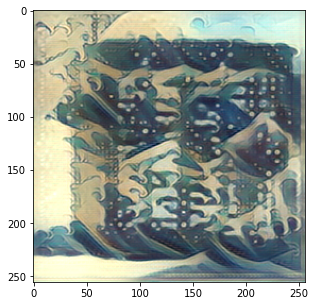

Saved sample stylized image at wave/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	534557.56
	Style Loss:	404383.43
	Total Loss:	938940.90
Time elapsed:	3204.2098636627197 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_14000.pth


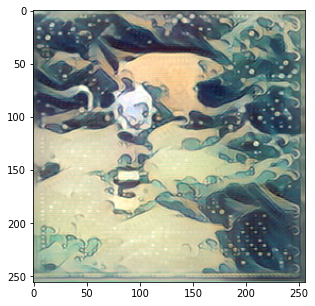

Saved sample stylized image at wave/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	533157.69
	Style Loss:	395115.56
	Total Loss:	928272.88
Time elapsed:	3319.0336849689484 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_14500.pth


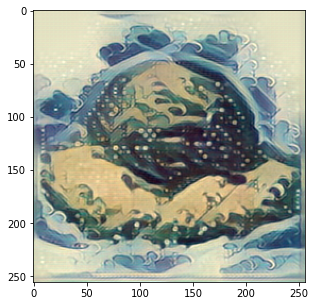

Saved sample stylized image at wave/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	531649.75
	Style Loss:	386475.22
	Total Loss:	918124.96
Time elapsed:	3433.2933373451233 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_15000.pth


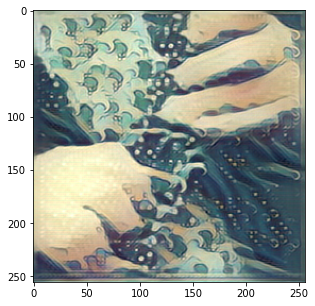

Saved sample stylized image at wave/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	530295.81
	Style Loss:	378276.46
	Total Loss:	908572.52
Time elapsed:	3547.8240320682526 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_15500.pth


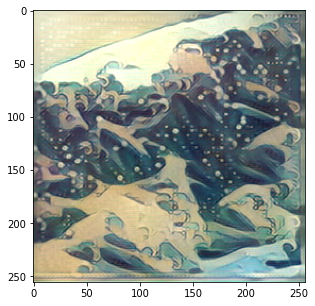

Saved sample stylized image at wave/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	529074.94
	Style Loss:	370513.44
	Total Loss:	899588.79
Time elapsed:	3661.970887899399 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_16000.pth


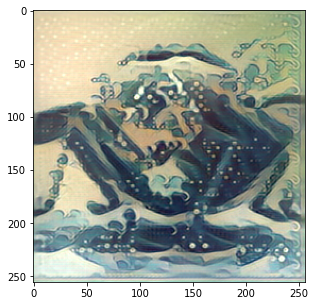

Saved sample stylized image at wave/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	527832.38
	Style Loss:	363227.99
	Total Loss:	891060.34
Time elapsed:	3776.8097364902496 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_16500.pth


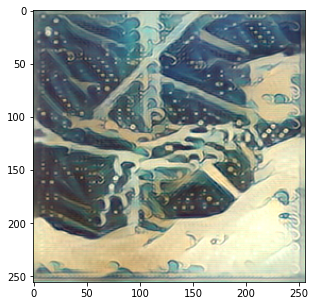

Saved sample stylized image at wave/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	526888.50
	Style Loss:	356325.18
	Total Loss:	883212.82
Time elapsed:	3890.912338256836 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_17000.pth


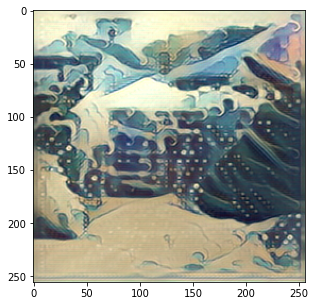

Saved sample stylized image at wave/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	525604.81
	Style Loss:	349774.19
	Total Loss:	875378.48
Time elapsed:	4005.440192461014 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_17500.pth


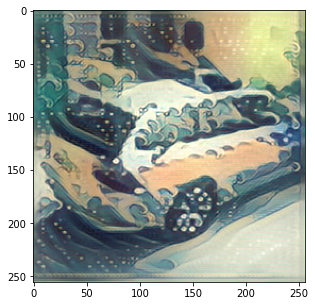

Saved sample stylized image at wave/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	524707.56
	Style Loss:	343689.27
	Total Loss:	868395.90
Time elapsed:	4119.69983458519 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_18000.pth


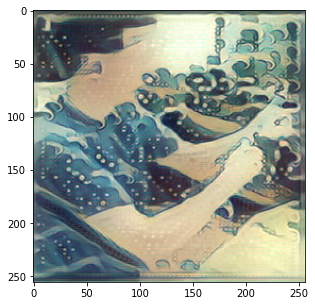

Saved sample stylized image at wave/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	523374.69
	Style Loss:	337813.25
	Total Loss:	861186.87
Time elapsed:	4234.456324338913 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_18500.pth


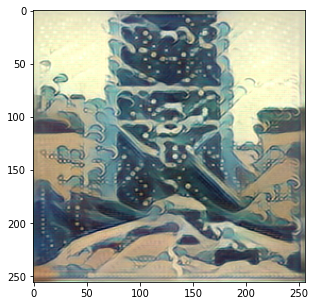

Saved sample stylized image at wave/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	522671.34
	Style Loss:	332260.47
	Total Loss:	854930.60
Time elapsed:	4348.599186897278 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_19000.pth


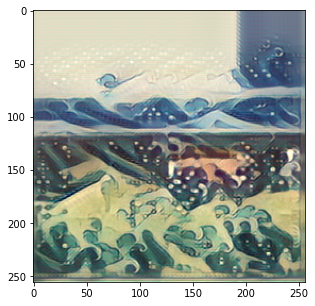

Saved sample stylized image at wave/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	521463.16
	Style Loss:	326926.35
	Total Loss:	848388.50
Time elapsed:	4463.294928789139 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_19500.pth


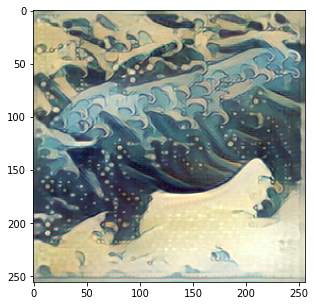

Saved sample stylized image at wave/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	520561.50
	Style Loss:	321863.22
	Total Loss:	842423.94
Time elapsed:	4577.527688026428 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_20000.pth


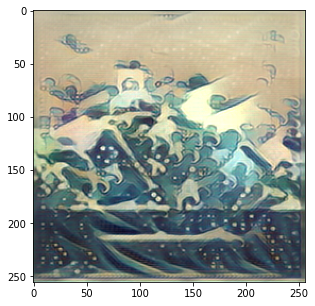

Saved sample stylized image at wave/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	519723.66
	Style Loss:	317056.71
	Total Loss:	836779.82
Time elapsed:	4692.268829107285 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_20500.pth


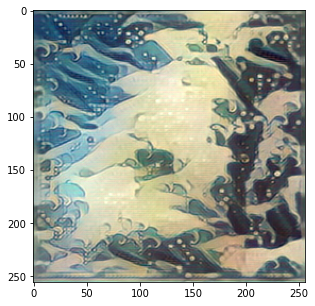

Saved sample stylized image at wave/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	519078.44
	Style Loss:	312454.33
	Total Loss:	831532.18
Time elapsed:	4806.359838724136 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_21000.pth


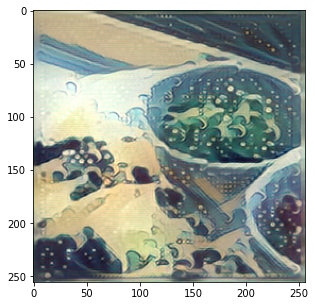

Saved sample stylized image at wave/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	518399.88
	Style Loss:	308003.58
	Total Loss:	826402.78
Time elapsed:	4921.142622232437 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_21500.pth


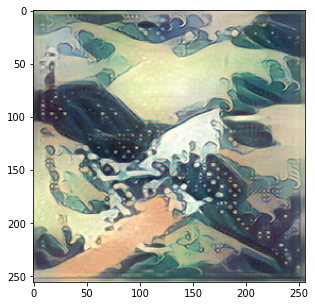

Saved sample stylized image at wave/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	517447.19
	Style Loss:	303797.55
	Total Loss:	821243.94
Time elapsed:	5035.5535452365875 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_22000.pth


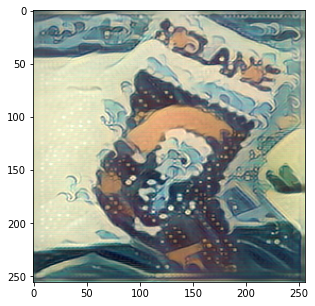

Saved sample stylized image at wave/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	516502.25
	Style Loss:	299763.27
	Total Loss:	816264.34
Time elapsed:	5150.573155641556 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_22500.pth


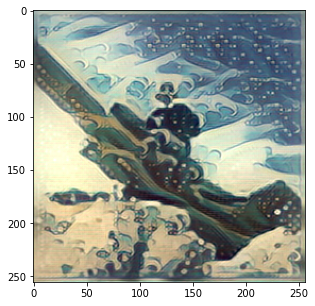

Saved sample stylized image at wave/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	516011.34
	Style Loss:	295888.24
	Total Loss:	811898.24
Time elapsed:	5264.935399532318 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_23000.pth


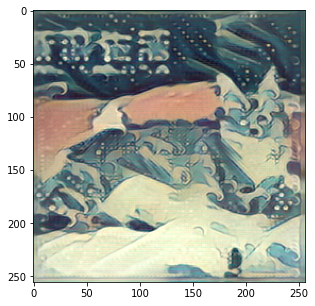

Saved sample stylized image at wave/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	515027.44
	Style Loss:	292140.54
	Total Loss:	807166.75
Time elapsed:	5379.762067317963 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_23500.pth


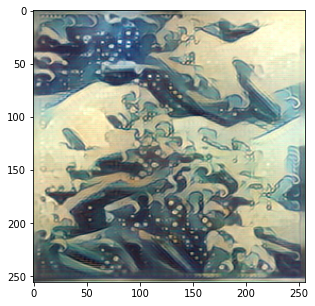

Saved sample stylized image at wave/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	514130.91
	Style Loss:	288543.50
	Total Loss:	802672.98
Time elapsed:	5494.419074296951 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24000.pth


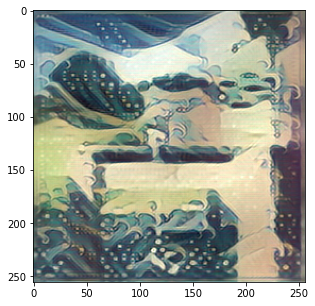

Saved sample stylized image at wave/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	513664.56
	Style Loss:	285117.44
	Total Loss:	798780.30
Time elapsed:	5609.819435119629 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24500.pth


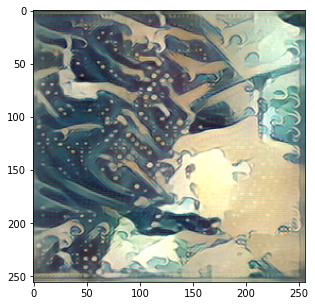

Saved sample stylized image at wave/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	512951.53
	Style Loss:	281802.95
	Total Loss:	794752.66
Time elapsed:	5724.556935787201 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24999.pth


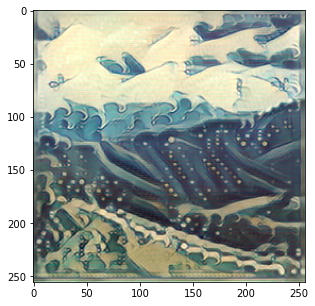

Saved sample stylized image at wave/images/sample0_24999.png
Done Training the Network!
Training Time: 5724.759708404541 seconds
========Content Loss========
[39215764.0, 6388028.148453094, 3838412.612887113, 2912845.3876582277, 2422258.4626436783, 2111150.37657437, 1898329.3468010663, 1739376.4951978007, 1616967.087587478, 1522122.6618390358, 1441631.7447885424, 1374981.3290310854, 1318307.8769007248, 1270132.3753797493, 1228530.686218933, 1192204.1160970205, 1160230.6909487876, 1131386.638689566, 1104551.3294946395, 1080732.615376013, 1059379.750009374, 1039644.2295614703, 1021566.3743125625, 1005104.8630771238, 989479.4538267645, 975445.0779287657, 962787.68943014, 950346.8175181468, 938940.9035426041, 928272.8827279153, 918124.9595610292, 908572.5185996065, 899588.7938117149, 891060.3396214624, 883212.8245323804, 875378.4784869436, 868395.8979778901, 861186.8730761175, 854930.596797537, 848388.5028764551, 842423.9404264162, 836779.8235970197, 831532.1799586924, 826402.7822572206, 8

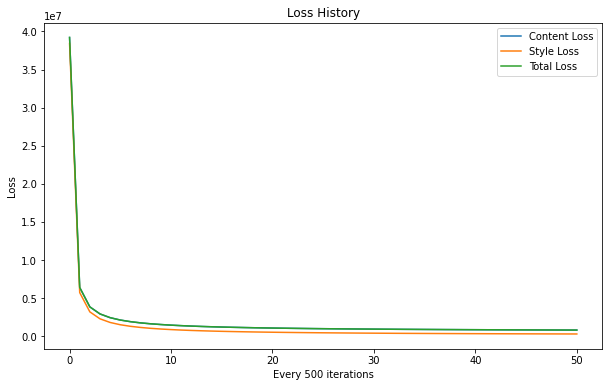

In [29]:
train()

In [30]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/wave/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/wave/